In [1]:
%matplotlib inline
import copy
import h5py
import json
import math
import numpy as np
import os
import re
import subprocess
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Dense, Dropout
from keras.optimizers import Adam, SGD
from keras.preprocessing import image
from keras.backend.tensorflow_backend import set_session
from keras.metrics import top_k_categorical_accuracy
from PIL import Image
from scipy.spatial.distance import cosine as cosine_distance
from matplotlib.pyplot import imshow
import matplotlib.pyplot as plt
import matplotlib.colors as mcolor
from tqdm import tqdm

config = tf.ConfigProto()
config.gpu_options.per_process_gpu_memory_fraction = 0.25
set_session(tf.Session(config=config))

Using TensorFlow backend.


In [2]:
def list_to_dict(objs):
    dobj = {}
    for i, obj in enumerate(objs):
        dobj[obj] = i
        
    return dobj

In [3]:
raw_objects = ['person','bicycle','car','motorbike','aeroplane','bus','train','truck','boat','traffic light','fire hydrant','stop sign','parking meter','bench','bird','cat','dog','horse','sheep','cow','elephant','bear','zebra','giraffe','backpack','umbrella','handbag','tie','suitcase','frisbee','skis','snowboard','sports ball','kite','baseball bat','baseball glove','skateboard','surfboard','tennis racket','bottle','wine glass','cup','fork','knife','spoon','bowl','banana','apple','sandwich','orange','broccoli','carrot','hot dog','pizza','donut','cake','chair','sofa','pottedplant','bed','diningtable','toilet','tvmonitor','laptop','mouse','remote','keyboard','cell phone','microwave','oven','toaster','sink','refrigerator','book','clock','vase','scissors','teddy bear','hair drier','toothbrush']

In [4]:
objdict = list_to_dict(raw_objects)

In [5]:
n_classes = 80
def multi_hot(ds):
    a = np.zeros(n_classes)
    
    for di, dv in ds.items():
        a[objdict[di]] = dv
        
    return a

In [6]:
nclass = 4
def to_one_hot(m, ns):
    p = np.zeros((m, nclass), dtype=int)
    
    for i, n in enumerate(ns):
        p[i, n-1] = 1
    
    return p

In [7]:
def resample(a, t):
    n = np.zeros(t)
    l = len(a)
    f = l / t
    
    for i in range(0, t):
        lb = math.ceil(i * f)
        ub = math.floor((i + 1) * f) + 1
        n[i] = np.mean(a[lb:ub])
        
    return n

In [8]:
def redistribute(a, t, i):
    rd = np.zeros(t)
    half = int(t / 2)
    rd_pos = 0
    
    for k in range(i - half, i):
        if k >= 0:
            rd[rd_pos] = a[k]
            
        rd_pos = rd_pos + 1
        
    for k in range(i + 1, i + half + 1):
        if k < len(a):
            rd[rd_pos] = a[k]
        rd_pos = rd_pos + 1
        
    return rd

In [9]:
base_path = '/home/gbudiman/Documents/effigy/figs'
max_val = 352 * 288

def stringify(i):
    return 'fig{0:08d}.jpg'.format(i)

def get_integer(s):
    match = re.match(r'fig(\d+)\.jpg', s)

    if match: return int(match.group(1))
    else: return None
        
def open_image_as_array(video, frame):
    im = Image.open(os.path.join(base_path, video, frame))
    return np.asarray(im, dtype=float) / 255

def get_hsl_stats(video, frames):
    hues = []
    sats = []
    lvs = []

    for frame in frames:
        ia = open_image_as_array(video, stringify(frame[0]))
        hue, sat, lv = get_hsl(ia)
        hues.append(hue)
        sats.append(sat)
        lvs.append(lv)

    sats_max = np.max(sats)
    lvs_max = np.max(lvs)

    return hues, np.array(sats) / sats_max, np.array(lvs) / lvs_max

def get_hsl(a):
    hsv = mcolor.rgb_to_hsv(a)

    hue = np.sum(hsv[:,:,0])
    saturation = np.sum(hsv[:,:,1])
    lightness = np.sum(hsv[:,:,2])

    return hue / max_val, saturation / max_val, lightness / max_val

In [10]:
def load_data(movies):
    Xs = []
    moviescenes = {}
    
    for movie in movies:
        file = 'features_' + movie + '.h5'
        hf = h5py.File(file, 'r')
        
        framelist = np.array(hf.get('frames'))
        features = np.array(hf.get('features'))
        
        moviescenes[movie] = framelist
        arr_features = []
        arr_dist = []
        for idx, feature in enumerate(features):
            feature = np.array(feature)
            
            dist = []
            for cmp_feature in features:
                dist.append(cosine_distance(feature, cmp_feature))
                
            #dist = np.array(dist)
            #resampled = resample(dist, 24)
            resampled = redistribute(dist, 24, idx)
            #dist = np.array(resampled)
            #stage = np.append(feature, dist)
            #Xs.append(stage)
            arr_features.append(feature)
            arr_dist.append(resampled)
            
        arr_yolo = build_yolo_jobs(movie, framelist)
        hues, sats, lvs = get_hsl_stats(movie, framelist)
        
        #print(arr_features)
        #print(arr_dist)
        #print(arr_yolo)
        for z in zip(arr_features, arr_dist, arr_yolo, hues, sats, lvs):
            #fl = np.array(z[0])
            fl = np.array(z[1])
            #fl = np.append(fl, z[1])
            fl = np.append(fl, z[2])
            fl = np.append(fl, z[3])
            fl = np.append(fl, z[4])
            fl = np.append(fl, z[5])
            Xs.append(fl)

    
    return np.array(Xs), framelist

In [11]:
base_path = '/home/gbudiman/Documents/effigy/figs'

def stringify(i):
    return 'fig{0:08d}.jpg'.format(i)

def build_yolo_jobs(movie, f):
    paths = []
    for frames in f:
        for _frame in frames:
            paths.append(stringify(_frame))
            
    return launch_yolo(movie, paths)
        
def launch_yolo(movie, _paths):
    paths = ' '.join(_paths)
    multi_hots = []
    cmd = ['/home/gbudiman/Documents/darknet/darknet',
           'batch_detect',
           '/home/gbudiman/Documents/darknet/cfg/yolo.cfg',
           '/home/gbudiman/Documents/darknet/yolo.weights',
           os.path.join(base_path, movie),
           paths]
    
    os.system(' '.join(cmd) + ' > tmp')
    for detection in parse_tmp_file():
        multi_hots.append(multi_hot(detection))
        
    return multi_hots
    
def parse_tmp_file():
    state = None
    result = []
    
    with open('tmp', 'r') as fp:
        content = fp.readlines()
        header_pattern = r'Predicted in'
        detection_pattern = r'^([\w\s]+)\: (\d+)'
        area_pattern = r'^(\d+) (\d+) (\d+) (\d+)'
        container = {}
        area = 0
        confidence = 0
        object_name = None
        
        for _line in content:
            line = _line.strip()
            header_match = re.search(header_pattern, line)
            detection_match = re.match(detection_pattern, line)
            area_match = re.match(area_pattern, line)
            
            if header_match:
                if state is not None:
                    result.append(container)
                    container = {}
                    
                state = 'frame'
            elif detection_match:
                object_name = detection_match.group(1)
                confidence = float(detection_match.group(2)) / 100
                state = 'object'
                
                if object_name not in container:
                    container[object_name] = 0
                
            elif area_match:
                tl0, tl1 = int(area_match.group(1)), int(area_match.group(2))
                br0, br1 = int(area_match.group(3)), int(area_match.group(4))
                area = abs(tl0 - br0) * abs(tl1 - br1) / (352 * 288)
                state = 'area'

                composite = area * confidence
                if composite > container[object_name]:
                    container[object_name] = composite
                    
        result.append(container)
                
    
    return result
        

In [12]:
movies = ['disney', 'hussein_day1', 'michael_day2', 'usc_week']
Xs, _unused = load_data(movies)
#y_apple         = [2,1,3,4,3,1,3,2,1,4,3,4,1,2,3,4,3,3,1,3,2,4,1,3,4,3,3,4,4,2,3,1,2,1,2,4,1,3,4,2,1,4,3]
y_apple         = []
y_disney        = [4,1,1,3,1,4,3,1,4,4,2,3,1,3,4,2,4,1,4,1,3,4,4,3,3,1,1,2,1,1,2,3,3,4,1,2,1,4,4,3,1,2,1,3,1,3]
y_hussein_day1  = [1,3,1,4,3,2,3,1,2,3,4,3,1,3,2,4,3,4,1,4,4,4,1,3,4,2,4,4,3,4,2,4,4,4,4,2,2,4,3,2,2,2,3,2,2,2,4,3,4,4,4,1]
y_michael_day2  = [2,4,4,3,3,2,4,2,4,4,4,3,4,2,4,4,4,4,4,4,3,4,3,4,4,4,2,2,1,3,3,4,4,4,3,1,3,1,1,1,2,4,1,1,1]
y_usc_week      = [3,2,4,4,4,1,4,4,4,4,4,1,3,2,1,3,2,1,4,4,4,3,1,2,4,3,3,2,4,1,1,2,3,2,4,4,4,4,2,1,2,1,2,3,2,1,2,4,4,2]

y = y_apple + y_disney + y_hussein_day1 + y_michael_day2 + y_usc_week
Ys = to_one_hot(len(y), y)

In [13]:
def top_2_categorical_accuracy(y_true, y_pred):
    return top_k_categorical_accuracy(y_true, y_pred, k=2)

def generate_model():
    sgd = SGD(lr=0.01, momentum=0.8, decay=0.0)
    model = Sequential()
    #model.add(Dense(4, input_shape=(24 + 80 + 3,), activation='softmax', kernel_initializer='random_uniform', bias_initializer='zeros'))
    
    model.add(Dense(16, input_shape=(24 + 80 + 3,), activation='softmax', kernel_initializer='random_uniform', bias_initializer='zeros'))
    model.add(Dropout(0.2))
    model.add(Dense(4, input_shape=(16,), activation='softmax', kernel_initializer='random_uniform', bias_initializer='zeros'))
    model.summary()
    model.compile(Adam(lr=0.01), loss='categorical_crossentropy', metrics=['accuracy'])
    
    return model

In [14]:
model = generate_model()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 16)                1728      
_________________________________________________________________
dropout_1 (Dropout)          (None, 16)                0         
_________________________________________________________________
dense_2 (Dense)              (None, 4)                 68        
Total params: 1,796.0
Trainable params: 1,796.0
Non-trainable params: 0.0
_________________________________________________________________


In [16]:
model.fit(Xs, Ys, epochs=10000, batch_size=32)

Epoch 1/10000
193/193 [==============================] - 0s - loss: 1.3810 - acc: 0.3109     
Epoch 2/10000
193/193 [==============================] - 0s - loss: 1.3658 - acc: 0.3731     
Epoch 3/10000
193/193 [==============================] - 0s - loss: 1.3528 - acc: 0.3731     
Epoch 4/10000
193/193 [==============================] - 0s - loss: 1.3520 - acc: 0.3731     
Epoch 5/10000
193/193 [==============================] - 0s - loss: 1.3465 - acc: 0.3731     
Epoch 6/10000
193/193 [==============================] - 0s - loss: 1.3473 - acc: 0.3731     
Epoch 7/10000
193/193 [==============================] - 0s - loss: 1.3516 - acc: 0.3731     
Epoch 8/10000
193/193 [==============================] - 0s - loss: 1.3517 - acc: 0.3731     
Epoch 9/10000
193/193 [==============================] - 0s - loss: 1.3474 - acc: 0.3731     
Epoch 10/10000
193/193 [==============================] - 0s - loss: 1.3511 - acc: 0.3731     
Epoch 11/10000
193/193 [==============================] - 0

193/193 [==============================] - 0s - loss: 1.2914 - acc: 0.4249     
Epoch 88/10000
193/193 [==============================] - 0s - loss: 1.2780 - acc: 0.4093     
Epoch 89/10000
193/193 [==============================] - 0s - loss: 1.2642 - acc: 0.4301     
Epoch 90/10000
193/193 [==============================] - 0s - loss: 1.2792 - acc: 0.4093     
Epoch 91/10000
193/193 [==============================] - 0s - loss: 1.2776 - acc: 0.3990     
Epoch 92/10000
193/193 [==============================] - 0s - loss: 1.2731 - acc: 0.3990     
Epoch 93/10000
193/193 [==============================] - 0s - loss: 1.2580 - acc: 0.4249     
Epoch 94/10000
193/193 [==============================] - 0s - loss: 1.2527 - acc: 0.4404     
Epoch 95/10000
193/193 [==============================] - 0s - loss: 1.2852 - acc: 0.4352     
Epoch 96/10000
193/193 [==============================] - 0s - loss: 1.2526 - acc: 0.4404     
Epoch 97/10000
193/193 [==============================] - 0s - lo

193/193 [==============================] - 0s - loss: 1.2325 - acc: 0.4870     
Epoch 173/10000
193/193 [==============================] - 0s - loss: 1.2097 - acc: 0.4508     
Epoch 174/10000
193/193 [==============================] - 0s - loss: 1.2144 - acc: 0.4560     
Epoch 175/10000
193/193 [==============================] - 0s - loss: 1.2341 - acc: 0.4611     
Epoch 176/10000
193/193 [==============================] - 0s - loss: 1.1959 - acc: 0.4611     
Epoch 177/10000
193/193 [==============================] - 0s - loss: 1.2021 - acc: 0.4767     
Epoch 178/10000
193/193 [==============================] - 0s - loss: 1.2166 - acc: 0.4404     
Epoch 179/10000
193/193 [==============================] - 0s - loss: 1.2407 - acc: 0.4560     
Epoch 180/10000
193/193 [==============================] - 0s - loss: 1.2422 - acc: 0.4352     
Epoch 181/10000
193/193 [==============================] - 0s - loss: 1.1941 - acc: 0.4560     
Epoch 182/10000
193/193 [==============================]

193/193 [==============================] - 0s - loss: 1.1482 - acc: 0.5078     
Epoch 258/10000
193/193 [==============================] - 0s - loss: 1.1569 - acc: 0.4715     
Epoch 259/10000
193/193 [==============================] - 0s - loss: 1.1276 - acc: 0.5078     
Epoch 260/10000
193/193 [==============================] - 0s - loss: 1.1762 - acc: 0.4352     
Epoch 261/10000
193/193 [==============================] - 0s - loss: 1.1844 - acc: 0.4456     
Epoch 262/10000
193/193 [==============================] - 0s - loss: 1.1752 - acc: 0.4508     
Epoch 263/10000
193/193 [==============================] - 0s - loss: 1.1569 - acc: 0.4352     
Epoch 264/10000
193/193 [==============================] - 0s - loss: 1.1458 - acc: 0.4663     
Epoch 265/10000
193/193 [==============================] - 0s - loss: 1.1659 - acc: 0.4715     
Epoch 266/10000
193/193 [==============================] - 0s - loss: 1.1430 - acc: 0.4922     
Epoch 267/10000
193/193 [==============================]

193/193 [==============================] - 0s - loss: 1.1122 - acc: 0.5389     
Epoch 343/10000
193/193 [==============================] - 0s - loss: 1.0713 - acc: 0.5544     
Epoch 344/10000
193/193 [==============================] - 0s - loss: 1.0858 - acc: 0.5285     
Epoch 345/10000
193/193 [==============================] - 0s - loss: 1.1025 - acc: 0.5078     
Epoch 346/10000
193/193 [==============================] - 0s - loss: 1.0913 - acc: 0.4974     
Epoch 347/10000
193/193 [==============================] - 0s - loss: 1.0770 - acc: 0.5233     
Epoch 348/10000
193/193 [==============================] - 0s - loss: 1.1090 - acc: 0.4922     
Epoch 349/10000
193/193 [==============================] - 0s - loss: 1.1617 - acc: 0.5026     
Epoch 350/10000
193/193 [==============================] - 0s - loss: 1.1335 - acc: 0.4819     
Epoch 351/10000
193/193 [==============================] - 0s - loss: 1.1056 - acc: 0.5130     
Epoch 352/10000
193/193 [==============================]

193/193 [==============================] - 0s - loss: 1.0518 - acc: 0.5130     
Epoch 428/10000
193/193 [==============================] - 0s - loss: 1.0698 - acc: 0.5233     
Epoch 429/10000
193/193 [==============================] - 0s - loss: 1.0543 - acc: 0.5026     
Epoch 430/10000
193/193 [==============================] - 0s - loss: 1.0647 - acc: 0.4922     
Epoch 431/10000
193/193 [==============================] - 0s - loss: 1.0080 - acc: 0.5337     
Epoch 432/10000
193/193 [==============================] - 0s - loss: 1.0549 - acc: 0.5596     
Epoch 433/10000
193/193 [==============================] - 0s - loss: 1.2089 - acc: 0.4611     
Epoch 434/10000
193/193 [==============================] - 0s - loss: 1.0594 - acc: 0.5285     
Epoch 435/10000
193/193 [==============================] - 0s - loss: 1.0369 - acc: 0.5285     
Epoch 436/10000
193/193 [==============================] - 0s - loss: 1.0046 - acc: 0.5648     
Epoch 437/10000
193/193 [==============================]

193/193 [==============================] - 0s - loss: 0.9723 - acc: 0.5492     
Epoch 513/10000
193/193 [==============================] - 0s - loss: 0.9796 - acc: 0.5959     
Epoch 514/10000
193/193 [==============================] - 0s - loss: 0.9552 - acc: 0.5544     
Epoch 515/10000
193/193 [==============================] - 0s - loss: 1.0309 - acc: 0.5233     
Epoch 516/10000
193/193 [==============================] - 0s - loss: 1.0276 - acc: 0.5440     
Epoch 517/10000
193/193 [==============================] - 0s - loss: 0.9917 - acc: 0.5337     
Epoch 518/10000
193/193 [==============================] - 0s - loss: 0.9927 - acc: 0.6010     
Epoch 519/10000
193/193 [==============================] - 0s - loss: 0.9960 - acc: 0.5492     
Epoch 520/10000
193/193 [==============================] - 0s - loss: 1.0159 - acc: 0.5337     
Epoch 521/10000
193/193 [==============================] - 0s - loss: 0.9839 - acc: 0.5751     
Epoch 522/10000
193/193 [==============================]

193/193 [==============================] - 0s - loss: 1.0160 - acc: 0.5233     
Epoch 598/10000
193/193 [==============================] - 0s - loss: 0.9923 - acc: 0.5233     
Epoch 599/10000
193/193 [==============================] - 0s - loss: 0.9485 - acc: 0.5544     
Epoch 600/10000
193/193 [==============================] - 0s - loss: 0.9281 - acc: 0.5803     
Epoch 601/10000
193/193 [==============================] - 0s - loss: 0.9343 - acc: 0.5855     
Epoch 602/10000
193/193 [==============================] - 0s - loss: 1.0216 - acc: 0.4974     
Epoch 603/10000
193/193 [==============================] - 0s - loss: 1.0229 - acc: 0.5285     
Epoch 604/10000
193/193 [==============================] - 0s - loss: 1.0598 - acc: 0.4974     
Epoch 605/10000
193/193 [==============================] - 0s - loss: 1.0104 - acc: 0.5699     
Epoch 606/10000
193/193 [==============================] - 0s - loss: 1.0595 - acc: 0.5492     
Epoch 607/10000
193/193 [==============================]

193/193 [==============================] - 0s - loss: 0.9514 - acc: 0.5699     
Epoch 683/10000
193/193 [==============================] - 0s - loss: 0.8831 - acc: 0.6321     
Epoch 684/10000
193/193 [==============================] - 0s - loss: 0.9388 - acc: 0.6062     
Epoch 685/10000
193/193 [==============================] - 0s - loss: 0.8881 - acc: 0.5751     
Epoch 686/10000
193/193 [==============================] - 0s - loss: 0.9158 - acc: 0.5648     
Epoch 687/10000
193/193 [==============================] - 0s - loss: 0.9561 - acc: 0.5440     
Epoch 688/10000
193/193 [==============================] - 0s - loss: 0.9057 - acc: 0.5959     
Epoch 689/10000
193/193 [==============================] - 0s - loss: 0.8978 - acc: 0.5803     
Epoch 690/10000
193/193 [==============================] - 0s - loss: 0.9837 - acc: 0.5389     
Epoch 691/10000
193/193 [==============================] - 0s - loss: 0.9424 - acc: 0.6010     
Epoch 692/10000
193/193 [==============================]

193/193 [==============================] - 0s - loss: 0.9472 - acc: 0.5596     
Epoch 768/10000
193/193 [==============================] - 0s - loss: 0.9153 - acc: 0.5699     
Epoch 769/10000
193/193 [==============================] - 0s - loss: 0.9714 - acc: 0.5440     
Epoch 770/10000
193/193 [==============================] - 0s - loss: 0.8949 - acc: 0.6010     
Epoch 771/10000
193/193 [==============================] - 0s - loss: 0.8748 - acc: 0.5803     
Epoch 772/10000
193/193 [==============================] - 0s - loss: 0.8673 - acc: 0.6062     
Epoch 773/10000
193/193 [==============================] - 0s - loss: 0.8526 - acc: 0.6321     
Epoch 774/10000
193/193 [==============================] - 0s - loss: 0.8999 - acc: 0.6269     
Epoch 775/10000
193/193 [==============================] - 0s - loss: 0.9212 - acc: 0.5855     
Epoch 776/10000
193/193 [==============================] - 0s - loss: 0.9070 - acc: 0.5751     
Epoch 777/10000
193/193 [==============================]

193/193 [==============================] - 0s - loss: 0.8555 - acc: 0.5803     
Epoch 853/10000
193/193 [==============================] - 0s - loss: 0.8772 - acc: 0.5855     
Epoch 854/10000
193/193 [==============================] - 0s - loss: 0.8574 - acc: 0.6269     
Epoch 855/10000
193/193 [==============================] - 0s - loss: 0.8909 - acc: 0.5699     
Epoch 856/10000
193/193 [==============================] - 0s - loss: 0.8627 - acc: 0.5855     
Epoch 857/10000
193/193 [==============================] - 0s - loss: 0.8872 - acc: 0.5751     
Epoch 858/10000
193/193 [==============================] - 0s - loss: 0.8519 - acc: 0.6010     
Epoch 859/10000
193/193 [==============================] - 0s - loss: 0.8895 - acc: 0.5751     
Epoch 860/10000
193/193 [==============================] - 0s - loss: 0.8564 - acc: 0.6062     
Epoch 861/10000
193/193 [==============================] - 0s - loss: 0.8937 - acc: 0.6010     
Epoch 862/10000
193/193 [==============================]

193/193 [==============================] - 0s - loss: 0.8923 - acc: 0.5907     
Epoch 938/10000
193/193 [==============================] - 0s - loss: 0.8450 - acc: 0.6269     
Epoch 939/10000
193/193 [==============================] - 0s - loss: 0.8836 - acc: 0.6269     
Epoch 940/10000
193/193 [==============================] - 0s - loss: 0.8644 - acc: 0.5855     
Epoch 941/10000
193/193 [==============================] - 0s - loss: 0.7613 - acc: 0.6995     
Epoch 942/10000
193/193 [==============================] - 0s - loss: 0.8112 - acc: 0.6580     
Epoch 943/10000
193/193 [==============================] - 0s - loss: 0.8762 - acc: 0.5699     
Epoch 944/10000
193/193 [==============================] - 0s - loss: 0.8072 - acc: 0.6114     
Epoch 945/10000
193/193 [==============================] - 0s - loss: 0.8022 - acc: 0.6321     
Epoch 946/10000
193/193 [==============================] - 0s - loss: 0.8700 - acc: 0.6114     
Epoch 947/10000
193/193 [==============================]

193/193 [==============================] - 0s - loss: 0.8252 - acc: 0.6269     
Epoch 1023/10000
193/193 [==============================] - 0s - loss: 0.8323 - acc: 0.6166     
Epoch 1024/10000
193/193 [==============================] - 0s - loss: 0.8303 - acc: 0.6425     
Epoch 1025/10000
193/193 [==============================] - 0s - loss: 0.7955 - acc: 0.6373     
Epoch 1026/10000
193/193 [==============================] - 0s - loss: 0.8519 - acc: 0.5959     
Epoch 1027/10000
193/193 [==============================] - 0s - loss: 0.8256 - acc: 0.6477     
Epoch 1028/10000
193/193 [==============================] - 0s - loss: 0.8124 - acc: 0.6062     
Epoch 1029/10000
193/193 [==============================] - 0s - loss: 0.8440 - acc: 0.6269     
Epoch 1030/10000
193/193 [==============================] - 0s - loss: 0.8122 - acc: 0.6114     
Epoch 1031/10000
193/193 [==============================] - 0s - loss: 0.8703 - acc: 0.5959     
Epoch 1032/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.8063 - acc: 0.6425     
Epoch 1107/10000
193/193 [==============================] - 0s - loss: 0.8946 - acc: 0.6321     
Epoch 1108/10000
193/193 [==============================] - 0s - loss: 0.8155 - acc: 0.6010     
Epoch 1109/10000
193/193 [==============================] - 0s - loss: 0.8607 - acc: 0.6166     
Epoch 1110/10000
193/193 [==============================] - 0s - loss: 0.7838 - acc: 0.6736     
Epoch 1111/10000
193/193 [==============================] - 0s - loss: 0.8103 - acc: 0.6684     
Epoch 1112/10000
193/193 [==============================] - 0s - loss: 0.8025 - acc: 0.6684     
Epoch 1113/10000
193/193 [==============================] - 0s - loss: 0.7908 - acc: 0.6891     
Epoch 1114/10000
193/193 [==============================] - 0s - loss: 0.8253 - acc: 0.6477     
Epoch 1115/10000
193/193 [==============================] - 0s - loss: 0.7917 - acc: 0.6477     
Epoch 1116/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.7920 - acc: 0.6684     
Epoch 1191/10000
193/193 [==============================] - 0s - loss: 0.7771 - acc: 0.6891     
Epoch 1192/10000
193/193 [==============================] - 0s - loss: 0.7579 - acc: 0.6580     
Epoch 1193/10000
193/193 [==============================] - 0s - loss: 0.8146 - acc: 0.6321     
Epoch 1194/10000
193/193 [==============================] - 0s - loss: 0.8997 - acc: 0.5959     
Epoch 1195/10000
193/193 [==============================] - 0s - loss: 0.8339 - acc: 0.6166     
Epoch 1196/10000
193/193 [==============================] - 0s - loss: 0.7805 - acc: 0.6269     
Epoch 1197/10000
193/193 [==============================] - 0s - loss: 0.8456 - acc: 0.6166     
Epoch 1198/10000
193/193 [==============================] - 0s - loss: 0.8376 - acc: 0.6166     
Epoch 1199/10000
193/193 [==============================] - 0s - loss: 0.8436 - acc: 0.6166     
Epoch 1200/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.7672 - acc: 0.6373     
Epoch 1275/10000
193/193 [==============================] - 0s - loss: 0.7562 - acc: 0.6891     
Epoch 1276/10000
193/193 [==============================] - 0s - loss: 0.8095 - acc: 0.6477     
Epoch 1277/10000
193/193 [==============================] - 0s - loss: 0.7411 - acc: 0.6788     
Epoch 1278/10000
193/193 [==============================] - 0s - loss: 0.7450 - acc: 0.6632     
Epoch 1279/10000
193/193 [==============================] - 0s - loss: 0.7309 - acc: 0.6891     
Epoch 1280/10000
193/193 [==============================] - 0s - loss: 0.8078 - acc: 0.6269     
Epoch 1281/10000
193/193 [==============================] - 0s - loss: 0.8120 - acc: 0.6528     
Epoch 1282/10000
193/193 [==============================] - 0s - loss: 0.8159 - acc: 0.6010     
Epoch 1283/10000
193/193 [==============================] - 0s - loss: 0.8320 - acc: 0.6166     
Epoch 1284/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.7767 - acc: 0.6218     
Epoch 1359/10000
193/193 [==============================] - 0s - loss: 0.7487 - acc: 0.6373     
Epoch 1360/10000
193/193 [==============================] - 0s - loss: 0.7705 - acc: 0.6528     
Epoch 1361/10000
193/193 [==============================] - 0s - loss: 0.7524 - acc: 0.6736     
Epoch 1362/10000
193/193 [==============================] - 0s - loss: 0.8141 - acc: 0.6632     
Epoch 1363/10000
193/193 [==============================] - 0s - loss: 0.7851 - acc: 0.6528     
Epoch 1364/10000
193/193 [==============================] - 0s - loss: 0.7328 - acc: 0.6943     
Epoch 1365/10000
193/193 [==============================] - 0s - loss: 0.7464 - acc: 0.6580     
Epoch 1366/10000
193/193 [==============================] - 0s - loss: 0.7742 - acc: 0.6736     
Epoch 1367/10000
193/193 [==============================] - 0s - loss: 0.7800 - acc: 0.6736     
Epoch 1368/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.7863 - acc: 0.6528     
Epoch 1443/10000
193/193 [==============================] - 0s - loss: 0.7902 - acc: 0.6269     
Epoch 1444/10000
193/193 [==============================] - 0s - loss: 0.7293 - acc: 0.6839     
Epoch 1445/10000
193/193 [==============================] - 0s - loss: 0.7654 - acc: 0.6425     
Epoch 1446/10000
193/193 [==============================] - 0s - loss: 0.7944 - acc: 0.6632     
Epoch 1447/10000
193/193 [==============================] - 0s - loss: 0.7844 - acc: 0.6788     
Epoch 1448/10000
193/193 [==============================] - 0s - loss: 0.7391 - acc: 0.6788     
Epoch 1449/10000
193/193 [==============================] - 0s - loss: 0.7318 - acc: 0.6736     
Epoch 1450/10000
193/193 [==============================] - 0s - loss: 0.8387 - acc: 0.6477     
Epoch 1451/10000
193/193 [==============================] - 0s - loss: 0.7437 - acc: 0.6528     
Epoch 1452/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.7957 - acc: 0.6632     
Epoch 1527/10000
193/193 [==============================] - ETA: 0s - loss: 0.7331 - acc: 0.562 - 0s - loss: 0.7709 - acc: 0.6321     
Epoch 1528/10000
193/193 [==============================] - 0s - loss: 0.8493 - acc: 0.6373     
Epoch 1529/10000
193/193 [==============================] - 0s - loss: 0.8324 - acc: 0.6580     
Epoch 1530/10000
193/193 [==============================] - 0s - loss: 0.7118 - acc: 0.6891     
Epoch 1531/10000
193/193 [==============================] - 0s - loss: 0.8515 - acc: 0.6010     
Epoch 1532/10000
193/193 [==============================] - 0s - loss: 0.8140 - acc: 0.6269     
Epoch 1533/10000
193/193 [==============================] - 0s - loss: 0.7749 - acc: 0.6321     
Epoch 1534/10000
193/193 [==============================] - 0s - loss: 0.8488 - acc: 0.6528     
Epoch 1535/10000
193/193 [==============================] - 0s - loss: 0.7688 - acc: 0.6839     
Epoch 153

193/193 [==============================] - 0s - loss: 0.7593 - acc: 0.6425     
Epoch 1611/10000
193/193 [==============================] - 0s - loss: 0.7305 - acc: 0.7047     
Epoch 1612/10000
193/193 [==============================] - 0s - loss: 0.6772 - acc: 0.7098     
Epoch 1613/10000
193/193 [==============================] - 0s - loss: 0.7682 - acc: 0.6528     
Epoch 1614/10000
193/193 [==============================] - 0s - loss: 0.7412 - acc: 0.6736     
Epoch 1615/10000
193/193 [==============================] - 0s - loss: 0.6924 - acc: 0.6839     
Epoch 1616/10000
193/193 [==============================] - 0s - loss: 0.7404 - acc: 0.6736     
Epoch 1617/10000
193/193 [==============================] - 0s - loss: 0.7694 - acc: 0.6788     
Epoch 1618/10000
193/193 [==============================] - 0s - loss: 0.7292 - acc: 0.6839     
Epoch 1619/10000
193/193 [==============================] - 0s - loss: 0.8217 - acc: 0.5907     
Epoch 1620/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.7128 - acc: 0.6995     
Epoch 1695/10000
193/193 [==============================] - 0s - loss: 0.7078 - acc: 0.6736     
Epoch 1696/10000
193/193 [==============================] - 0s - loss: 0.6872 - acc: 0.6943     
Epoch 1697/10000
193/193 [==============================] - 0s - loss: 0.7290 - acc: 0.6580     
Epoch 1698/10000
193/193 [==============================] - 0s - loss: 0.7055 - acc: 0.6995     
Epoch 1699/10000
193/193 [==============================] - 0s - loss: 0.7093 - acc: 0.7098     
Epoch 1700/10000
193/193 [==============================] - 0s - loss: 0.7030 - acc: 0.6995     
Epoch 1701/10000
193/193 [==============================] - 0s - loss: 0.6598 - acc: 0.7202     
Epoch 1702/10000
193/193 [==============================] - 0s - loss: 0.7358 - acc: 0.6477     
Epoch 1703/10000
193/193 [==============================] - 0s - loss: 0.7372 - acc: 0.6736     
Epoch 1704/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.7383 - acc: 0.6943     
Epoch 1779/10000
193/193 [==============================] - 0s - loss: 0.6930 - acc: 0.6995     
Epoch 1780/10000
193/193 [==============================] - 0s - loss: 0.6956 - acc: 0.7202     
Epoch 1781/10000
193/193 [==============================] - 0s - loss: 0.7640 - acc: 0.6425     
Epoch 1782/10000
193/193 [==============================] - 0s - loss: 0.7431 - acc: 0.6736     
Epoch 1783/10000
193/193 [==============================] - 0s - loss: 0.7451 - acc: 0.7098     
Epoch 1784/10000
193/193 [==============================] - 0s - loss: 0.6291 - acc: 0.7358     
Epoch 1785/10000
193/193 [==============================] - 0s - loss: 0.6975 - acc: 0.6943     
Epoch 1786/10000
193/193 [==============================] - 0s - loss: 0.6897 - acc: 0.7202     
Epoch 1787/10000
193/193 [==============================] - 0s - loss: 0.7604 - acc: 0.6788     
Epoch 1788/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.7758 - acc: 0.6373     
Epoch 1863/10000
193/193 [==============================] - 0s - loss: 0.7627 - acc: 0.6788     
Epoch 1864/10000
193/193 [==============================] - 0s - loss: 0.7148 - acc: 0.6373     
Epoch 1865/10000
193/193 [==============================] - 0s - loss: 0.7193 - acc: 0.6943     
Epoch 1866/10000
193/193 [==============================] - 0s - loss: 0.6812 - acc: 0.6736     
Epoch 1867/10000
193/193 [==============================] - 0s - loss: 0.6463 - acc: 0.7098     
Epoch 1868/10000
193/193 [==============================] - 0s - loss: 0.6727 - acc: 0.6684     
Epoch 1869/10000
193/193 [==============================] - 0s - loss: 0.7423 - acc: 0.6580     
Epoch 1870/10000
193/193 [==============================] - 0s - loss: 0.7320 - acc: 0.6528     
Epoch 1871/10000
193/193 [==============================] - 0s - loss: 0.7007 - acc: 0.6736     
Epoch 1872/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.6884 - acc: 0.6839     
Epoch 1947/10000
193/193 [==============================] - 0s - loss: 0.7512 - acc: 0.6839     
Epoch 1948/10000
193/193 [==============================] - 0s - loss: 0.7379 - acc: 0.6788     
Epoch 1949/10000
193/193 [==============================] - 0s - loss: 0.7717 - acc: 0.6736     
Epoch 1950/10000
193/193 [==============================] - 0s - loss: 0.6861 - acc: 0.7150     
Epoch 1951/10000
193/193 [==============================] - 0s - loss: 0.6884 - acc: 0.6891     
Epoch 1952/10000
193/193 [==============================] - 0s - loss: 0.7807 - acc: 0.6528     
Epoch 1953/10000
193/193 [==============================] - 0s - loss: 0.6978 - acc: 0.6995     
Epoch 1954/10000
193/193 [==============================] - 0s - loss: 0.6886 - acc: 0.7098     
Epoch 1955/10000
193/193 [==============================] - 0s - loss: 0.7316 - acc: 0.6891     
Epoch 1956/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.6747 - acc: 0.7150     
Epoch 2031/10000
193/193 [==============================] - 0s - loss: 0.6779 - acc: 0.6995     
Epoch 2032/10000
193/193 [==============================] - 0s - loss: 0.6943 - acc: 0.6528     
Epoch 2033/10000
193/193 [==============================] - 0s - loss: 0.6571 - acc: 0.6839     
Epoch 2034/10000
193/193 [==============================] - 0s - loss: 0.6549 - acc: 0.6995     
Epoch 2035/10000
193/193 [==============================] - 0s - loss: 0.6969 - acc: 0.6943     
Epoch 2036/10000
193/193 [==============================] - 0s - loss: 0.7428 - acc: 0.6373     
Epoch 2037/10000
193/193 [==============================] - 0s - loss: 0.6705 - acc: 0.6995     
Epoch 2038/10000
193/193 [==============================] - 0s - loss: 0.7779 - acc: 0.6839     
Epoch 2039/10000
193/193 [==============================] - 0s - loss: 0.7264 - acc: 0.6891     
Epoch 2040/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.7040 - acc: 0.6943     
Epoch 2115/10000
193/193 [==============================] - 0s - loss: 0.6776 - acc: 0.6839     
Epoch 2116/10000
193/193 [==============================] - 0s - loss: 0.7394 - acc: 0.6425     
Epoch 2117/10000
193/193 [==============================] - 0s - loss: 0.6414 - acc: 0.7150     
Epoch 2118/10000
193/193 [==============================] - 0s - loss: 0.7325 - acc: 0.6632     
Epoch 2119/10000
193/193 [==============================] - 0s - loss: 0.7270 - acc: 0.6321     
Epoch 2120/10000
193/193 [==============================] - 0s - loss: 0.6587 - acc: 0.6891     
Epoch 2121/10000
193/193 [==============================] - 0s - loss: 0.6635 - acc: 0.7254     
Epoch 2122/10000
193/193 [==============================] - 0s - loss: 0.6209 - acc: 0.7306     
Epoch 2123/10000
193/193 [==============================] - 0s - loss: 0.6996 - acc: 0.6943     
Epoch 2124/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.7060 - acc: 0.6995     
Epoch 2199/10000
193/193 [==============================] - 0s - loss: 0.6851 - acc: 0.7047     
Epoch 2200/10000
193/193 [==============================] - 0s - loss: 0.7318 - acc: 0.6425     
Epoch 2201/10000
193/193 [==============================] - 0s - loss: 0.6472 - acc: 0.7098     
Epoch 2202/10000
193/193 [==============================] - 0s - loss: 0.6811 - acc: 0.6943     
Epoch 2203/10000
193/193 [==============================] - 0s - loss: 0.6885 - acc: 0.7047     
Epoch 2204/10000
193/193 [==============================] - 0s - loss: 0.6274 - acc: 0.7150     
Epoch 2205/10000
193/193 [==============================] - 0s - loss: 0.6523 - acc: 0.7306     
Epoch 2206/10000
193/193 [==============================] - 0s - loss: 0.6576 - acc: 0.6788     
Epoch 2207/10000
193/193 [==============================] - 0s - loss: 0.6505 - acc: 0.7098     
Epoch 2208/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.6707 - acc: 0.7098     
Epoch 2283/10000
193/193 [==============================] - 0s - loss: 0.6581 - acc: 0.7461     
Epoch 2284/10000
193/193 [==============================] - 0s - loss: 0.6915 - acc: 0.6891     
Epoch 2285/10000
193/193 [==============================] - 0s - loss: 0.6753 - acc: 0.7098     
Epoch 2286/10000
193/193 [==============================] - 0s - loss: 0.6782 - acc: 0.7098     
Epoch 2287/10000
193/193 [==============================] - 0s - loss: 0.6108 - acc: 0.7461     
Epoch 2288/10000
193/193 [==============================] - 0s - loss: 0.6982 - acc: 0.6580     
Epoch 2289/10000
193/193 [==============================] - 0s - loss: 0.5885 - acc: 0.7461     
Epoch 2290/10000
193/193 [==============================] - 0s - loss: 0.6839 - acc: 0.6891     
Epoch 2291/10000
193/193 [==============================] - 0s - loss: 0.6127 - acc: 0.7565     
Epoch 2292/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.6507 - acc: 0.7150     
Epoch 2367/10000
193/193 [==============================] - 0s - loss: 0.7093 - acc: 0.6736     
Epoch 2368/10000
193/193 [==============================] - 0s - loss: 0.6180 - acc: 0.7461     
Epoch 2369/10000
193/193 [==============================] - 0s - loss: 0.6811 - acc: 0.6788     
Epoch 2370/10000
193/193 [==============================] - 0s - loss: 0.6567 - acc: 0.7098     
Epoch 2371/10000
193/193 [==============================] - 0s - loss: 0.7540 - acc: 0.7098     
Epoch 2372/10000
193/193 [==============================] - 0s - loss: 0.7954 - acc: 0.6632     
Epoch 2373/10000
193/193 [==============================] - 0s - loss: 0.7703 - acc: 0.6788     
Epoch 2374/10000
193/193 [==============================] - 0s - loss: 0.7433 - acc: 0.6943     
Epoch 2375/10000
193/193 [==============================] - 0s - loss: 0.7127 - acc: 0.7409     
Epoch 2376/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.6642 - acc: 0.7047     
Epoch 2451/10000
193/193 [==============================] - 0s - loss: 0.7285 - acc: 0.6580     
Epoch 2452/10000
193/193 [==============================] - 0s - loss: 0.6868 - acc: 0.7150     
Epoch 2453/10000
193/193 [==============================] - 0s - loss: 0.6723 - acc: 0.7098     
Epoch 2454/10000
193/193 [==============================] - 0s - loss: 0.6987 - acc: 0.6839     
Epoch 2455/10000
193/193 [==============================] - 0s - loss: 0.7360 - acc: 0.6269     
Epoch 2456/10000
193/193 [==============================] - 0s - loss: 0.6719 - acc: 0.6995     
Epoch 2457/10000
193/193 [==============================] - 0s - loss: 0.7837 - acc: 0.6632     
Epoch 2458/10000
193/193 [==============================] - 0s - loss: 0.7545 - acc: 0.6943     
Epoch 2459/10000
193/193 [==============================] - 0s - loss: 0.6388 - acc: 0.7254     
Epoch 2460/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.6583 - acc: 0.6839     
Epoch 2535/10000
193/193 [==============================] - 0s - loss: 0.6828 - acc: 0.6839     
Epoch 2536/10000
193/193 [==============================] - 0s - loss: 0.6979 - acc: 0.6788     
Epoch 2537/10000
193/193 [==============================] - 0s - loss: 0.6879 - acc: 0.6943     
Epoch 2538/10000
193/193 [==============================] - 0s - loss: 0.6079 - acc: 0.7358     
Epoch 2539/10000
193/193 [==============================] - 0s - loss: 0.6580 - acc: 0.7150     
Epoch 2540/10000
193/193 [==============================] - 0s - loss: 0.6765 - acc: 0.6995     
Epoch 2541/10000
193/193 [==============================] - 0s - loss: 0.5824 - acc: 0.7098     
Epoch 2542/10000
193/193 [==============================] - 0s - loss: 0.6141 - acc: 0.7047     
Epoch 2543/10000
193/193 [==============================] - 0s - loss: 0.7084 - acc: 0.6580     
Epoch 2544/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.8228 - acc: 0.6373     
Epoch 2619/10000
193/193 [==============================] - 0s - loss: 0.6813 - acc: 0.7254     
Epoch 2620/10000
193/193 [==============================] - 0s - loss: 0.6242 - acc: 0.6943     
Epoch 2621/10000
193/193 [==============================] - 0s - loss: 0.6618 - acc: 0.7047     
Epoch 2622/10000
193/193 [==============================] - 0s - loss: 0.6522 - acc: 0.7202     
Epoch 2623/10000
193/193 [==============================] - 0s - loss: 0.6520 - acc: 0.6943     
Epoch 2624/10000
193/193 [==============================] - 0s - loss: 0.7038 - acc: 0.6736     
Epoch 2625/10000
193/193 [==============================] - 0s - loss: 0.6356 - acc: 0.6995     
Epoch 2626/10000
193/193 [==============================] - 0s - loss: 0.6101 - acc: 0.7409     
Epoch 2627/10000
193/193 [==============================] - 0s - loss: 0.6565 - acc: 0.6943     
Epoch 2628/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.6634 - acc: 0.7306     
Epoch 2703/10000
193/193 [==============================] - 0s - loss: 0.6569 - acc: 0.6943     
Epoch 2704/10000
193/193 [==============================] - 0s - loss: 0.6349 - acc: 0.7461     
Epoch 2705/10000
193/193 [==============================] - 0s - loss: 0.7185 - acc: 0.6684     
Epoch 2706/10000
193/193 [==============================] - 0s - loss: 0.6581 - acc: 0.6684     
Epoch 2707/10000
193/193 [==============================] - 0s - loss: 0.6084 - acc: 0.7047     
Epoch 2708/10000
193/193 [==============================] - 0s - loss: 0.5879 - acc: 0.7513     
Epoch 2709/10000
193/193 [==============================] - 0s - loss: 0.6042 - acc: 0.7409     
Epoch 2710/10000
193/193 [==============================] - 0s - loss: 0.6480 - acc: 0.6943     
Epoch 2711/10000
193/193 [==============================] - 0s - loss: 0.6083 - acc: 0.7254     
Epoch 2712/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.5754 - acc: 0.7409     
Epoch 2787/10000
193/193 [==============================] - 0s - loss: 0.6313 - acc: 0.7306     
Epoch 2788/10000
193/193 [==============================] - 0s - loss: 0.6343 - acc: 0.7254     
Epoch 2789/10000
193/193 [==============================] - 0s - loss: 0.6448 - acc: 0.6995     
Epoch 2790/10000
193/193 [==============================] - 0s - loss: 0.6125 - acc: 0.7306     
Epoch 2791/10000
193/193 [==============================] - 0s - loss: 0.5733 - acc: 0.7772     
Epoch 2792/10000
193/193 [==============================] - 0s - loss: 0.6159 - acc: 0.7461     
Epoch 2793/10000
193/193 [==============================] - 0s - loss: 0.6375 - acc: 0.7306     
Epoch 2794/10000
193/193 [==============================] - 0s - loss: 0.5860 - acc: 0.7409     
Epoch 2795/10000
193/193 [==============================] - 0s - loss: 0.6534 - acc: 0.7047     
Epoch 2796/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.6367 - acc: 0.6995     
Epoch 2871/10000
193/193 [==============================] - 0s - loss: 0.5529 - acc: 0.7409     
Epoch 2872/10000
193/193 [==============================] - 0s - loss: 0.6495 - acc: 0.7150     
Epoch 2873/10000
193/193 [==============================] - 0s - loss: 0.7583 - acc: 0.6477     
Epoch 2874/10000
193/193 [==============================] - 0s - loss: 0.6708 - acc: 0.6891     
Epoch 2875/10000
193/193 [==============================] - 0s - loss: 0.5995 - acc: 0.7254     
Epoch 2876/10000
193/193 [==============================] - 0s - loss: 0.6236 - acc: 0.7047     
Epoch 2877/10000
193/193 [==============================] - 0s - loss: 0.5976 - acc: 0.7358     
Epoch 2878/10000
193/193 [==============================] - 0s - loss: 0.6653 - acc: 0.6891     
Epoch 2879/10000
193/193 [==============================] - 0s - loss: 0.6803 - acc: 0.6736     
Epoch 2880/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.6340 - acc: 0.6943     
Epoch 2955/10000
193/193 [==============================] - 0s - loss: 0.6900 - acc: 0.6580     
Epoch 2956/10000
193/193 [==============================] - 0s - loss: 0.6201 - acc: 0.7513     
Epoch 2957/10000
193/193 [==============================] - 0s - loss: 0.6746 - acc: 0.7098     
Epoch 2958/10000
193/193 [==============================] - 0s - loss: 0.6022 - acc: 0.7358     
Epoch 2959/10000
193/193 [==============================] - 0s - loss: 0.5533 - acc: 0.7513     
Epoch 2960/10000
193/193 [==============================] - 0s - loss: 0.5845 - acc: 0.7565     
Epoch 2961/10000
193/193 [==============================] - 0s - loss: 0.6146 - acc: 0.7202     
Epoch 2962/10000
193/193 [==============================] - 0s - loss: 0.5806 - acc: 0.7668     
Epoch 2963/10000
193/193 [==============================] - 0s - loss: 0.6587 - acc: 0.6943     
Epoch 2964/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.6835 - acc: 0.6788     
Epoch 3039/10000
193/193 [==============================] - 0s - loss: 0.6245 - acc: 0.7150     
Epoch 3040/10000
193/193 [==============================] - 0s - loss: 0.6368 - acc: 0.6995     
Epoch 3041/10000
193/193 [==============================] - 0s - loss: 0.5931 - acc: 0.7668     
Epoch 3042/10000
193/193 [==============================] - 0s - loss: 0.6370 - acc: 0.7150     
Epoch 3043/10000
193/193 [==============================] - 0s - loss: 0.6282 - acc: 0.7254     
Epoch 3044/10000
193/193 [==============================] - 0s - loss: 0.6562 - acc: 0.6580     
Epoch 3045/10000
193/193 [==============================] - 0s - loss: 0.6162 - acc: 0.7306     
Epoch 3046/10000
193/193 [==============================] - 0s - loss: 0.5937 - acc: 0.7876     
Epoch 3047/10000
193/193 [==============================] - 0s - loss: 0.5681 - acc: 0.7876     
Epoch 3048/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.5969 - acc: 0.7306     
Epoch 3123/10000
193/193 [==============================] - 0s - loss: 0.5654 - acc: 0.7565     
Epoch 3124/10000
193/193 [==============================] - 0s - loss: 0.5963 - acc: 0.7513     
Epoch 3125/10000
193/193 [==============================] - 0s - loss: 0.5459 - acc: 0.7772     
Epoch 3126/10000
193/193 [==============================] - ETA: 0s - loss: 0.5982 - acc: 0.750 - 0s - loss: 0.5998 - acc: 0.7202     
Epoch 3127/10000
193/193 [==============================] - 0s - loss: 0.5950 - acc: 0.7202     
Epoch 3128/10000
193/193 [==============================] - 0s - loss: 0.5877 - acc: 0.7306     
Epoch 3129/10000
193/193 [==============================] - 0s - loss: 0.6488 - acc: 0.7047     
Epoch 3130/10000
193/193 [==============================] - 0s - loss: 0.6085 - acc: 0.6995     
Epoch 3131/10000
193/193 [==============================] - 0s - loss: 0.6042 - acc: 0.7461     
Epoch 313

193/193 [==============================] - 0s - loss: 0.6438 - acc: 0.7202     
Epoch 3207/10000
193/193 [==============================] - 0s - loss: 0.5948 - acc: 0.7047     
Epoch 3208/10000
193/193 [==============================] - 0s - loss: 0.5975 - acc: 0.7150     
Epoch 3209/10000
193/193 [==============================] - 0s - loss: 0.6260 - acc: 0.7047     
Epoch 3210/10000
193/193 [==============================] - 0s - loss: 0.6701 - acc: 0.6528     
Epoch 3211/10000
193/193 [==============================] - 0s - loss: 0.6788 - acc: 0.6839     
Epoch 3212/10000
193/193 [==============================] - 0s - loss: 0.5754 - acc: 0.7876     
Epoch 3213/10000
193/193 [==============================] - 0s - loss: 0.6365 - acc: 0.7150     
Epoch 3214/10000
193/193 [==============================] - 0s - loss: 0.6336 - acc: 0.6995     
Epoch 3215/10000
193/193 [==============================] - 0s - loss: 0.5931 - acc: 0.7150     
Epoch 3216/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.6576 - acc: 0.7202     
Epoch 3291/10000
193/193 [==============================] - 0s - loss: 0.5866 - acc: 0.7202     
Epoch 3292/10000
193/193 [==============================] - 0s - loss: 0.5256 - acc: 0.7668     
Epoch 3293/10000
193/193 [==============================] - 0s - loss: 0.5982 - acc: 0.7202     
Epoch 3294/10000
193/193 [==============================] - 0s - loss: 0.5992 - acc: 0.7150     
Epoch 3295/10000
193/193 [==============================] - 0s - loss: 0.5552 - acc: 0.7358     
Epoch 3296/10000
193/193 [==============================] - 0s - loss: 0.6047 - acc: 0.7047     
Epoch 3297/10000
193/193 [==============================] - 0s - loss: 0.5730 - acc: 0.7513     
Epoch 3298/10000
193/193 [==============================] - 0s - loss: 0.5084 - acc: 0.7668     
Epoch 3299/10000
193/193 [==============================] - 0s - loss: 0.5623 - acc: 0.7254     
Epoch 3300/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.6598 - acc: 0.6788     
Epoch 3375/10000
193/193 [==============================] - 0s - loss: 0.5719 - acc: 0.7409     
Epoch 3376/10000
193/193 [==============================] - 0s - loss: 0.5286 - acc: 0.7617     
Epoch 3377/10000
193/193 [==============================] - 0s - loss: 0.6885 - acc: 0.6995     
Epoch 3378/10000
193/193 [==============================] - 0s - loss: 0.5893 - acc: 0.7513     
Epoch 3379/10000
193/193 [==============================] - 0s - loss: 0.5529 - acc: 0.7513     
Epoch 3380/10000
193/193 [==============================] - 0s - loss: 0.5536 - acc: 0.7617     
Epoch 3381/10000
193/193 [==============================] - 0s - loss: 0.5963 - acc: 0.7358     
Epoch 3382/10000
193/193 [==============================] - 0s - loss: 0.6157 - acc: 0.7098     
Epoch 3383/10000
193/193 [==============================] - 0s - loss: 0.5725 - acc: 0.7565     
Epoch 3384/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.5830 - acc: 0.7720     
Epoch 3459/10000
193/193 [==============================] - 0s - loss: 0.5736 - acc: 0.7409     
Epoch 3460/10000
193/193 [==============================] - 0s - loss: 0.5875 - acc: 0.7461     
Epoch 3461/10000
193/193 [==============================] - 0s - loss: 0.6217 - acc: 0.7254     
Epoch 3462/10000
193/193 [==============================] - 0s - loss: 0.6162 - acc: 0.7202     
Epoch 3463/10000
193/193 [==============================] - 0s - loss: 0.5357 - acc: 0.7720     
Epoch 3464/10000
193/193 [==============================] - 0s - loss: 0.5902 - acc: 0.7306     
Epoch 3465/10000
193/193 [==============================] - 0s - loss: 0.4860 - acc: 0.8135     
Epoch 3466/10000
193/193 [==============================] - 0s - loss: 0.5864 - acc: 0.7461     
Epoch 3467/10000
193/193 [==============================] - 0s - loss: 0.5797 - acc: 0.7617     
Epoch 3468/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.6119 - acc: 0.7047     
Epoch 3543/10000
193/193 [==============================] - 0s - loss: 0.6118 - acc: 0.7254     
Epoch 3544/10000
193/193 [==============================] - 0s - loss: 0.5047 - acc: 0.7565     
Epoch 3545/10000
193/193 [==============================] - 0s - loss: 0.6287 - acc: 0.7047     
Epoch 3546/10000
193/193 [==============================] - 0s - loss: 0.6075 - acc: 0.7306     
Epoch 3547/10000
193/193 [==============================] - 0s - loss: 0.6055 - acc: 0.7358     
Epoch 3548/10000
193/193 [==============================] - 0s - loss: 0.5227 - acc: 0.7720     
Epoch 3549/10000
193/193 [==============================] - 0s - loss: 0.5308 - acc: 0.7668     
Epoch 3550/10000
193/193 [==============================] - 0s - loss: 0.6151 - acc: 0.7409     
Epoch 3551/10000
193/193 [==============================] - 0s - loss: 0.5347 - acc: 0.7513     
Epoch 3552/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.5593 - acc: 0.7409     
Epoch 3627/10000
193/193 [==============================] - 0s - loss: 0.5542 - acc: 0.7617     
Epoch 3628/10000
193/193 [==============================] - 0s - loss: 0.5685 - acc: 0.7358     
Epoch 3629/10000
193/193 [==============================] - 0s - loss: 0.6864 - acc: 0.6736     
Epoch 3630/10000
193/193 [==============================] - 0s - loss: 0.5759 - acc: 0.7254     
Epoch 3631/10000
193/193 [==============================] - 0s - loss: 0.5369 - acc: 0.7358     
Epoch 3632/10000
193/193 [==============================] - 0s - loss: 0.6442 - acc: 0.7254     
Epoch 3633/10000
193/193 [==============================] - 0s - loss: 0.5410 - acc: 0.7617     
Epoch 3634/10000
193/193 [==============================] - 0s - loss: 0.5984 - acc: 0.7358     
Epoch 3635/10000
193/193 [==============================] - 0s - loss: 0.5812 - acc: 0.7098     
Epoch 3636/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.5740 - acc: 0.7461     
Epoch 3711/10000
193/193 [==============================] - 0s - loss: 0.5428 - acc: 0.7668     
Epoch 3712/10000
193/193 [==============================] - 0s - loss: 0.5426 - acc: 0.7979     
Epoch 3713/10000
193/193 [==============================] - 0s - loss: 0.5562 - acc: 0.7772     
Epoch 3714/10000
193/193 [==============================] - 0s - loss: 0.5774 - acc: 0.7254     
Epoch 3715/10000
193/193 [==============================] - 0s - loss: 0.5492 - acc: 0.7617     
Epoch 3716/10000
193/193 [==============================] - 0s - loss: 0.5725 - acc: 0.7513     
Epoch 3717/10000
193/193 [==============================] - 0s - loss: 0.6066 - acc: 0.7461     
Epoch 3718/10000
193/193 [==============================] - 0s - loss: 0.6053 - acc: 0.7306     
Epoch 3719/10000
193/193 [==============================] - 0s - loss: 0.6516 - acc: 0.7254     
Epoch 3720/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.5504 - acc: 0.7617     
Epoch 3795/10000
193/193 [==============================] - 0s - loss: 0.5775 - acc: 0.7254     
Epoch 3796/10000
193/193 [==============================] - 0s - loss: 0.6142 - acc: 0.7047     
Epoch 3797/10000
193/193 [==============================] - 0s - loss: 0.5863 - acc: 0.7513     
Epoch 3798/10000
193/193 [==============================] - 0s - loss: 0.5707 - acc: 0.7254     
Epoch 3799/10000
193/193 [==============================] - 0s - loss: 0.5251 - acc: 0.7565     
Epoch 3800/10000
193/193 [==============================] - 0s - loss: 0.5918 - acc: 0.7098     
Epoch 3801/10000
193/193 [==============================] - 0s - loss: 0.5282 - acc: 0.7358     
Epoch 3802/10000
193/193 [==============================] - 0s - loss: 0.5465 - acc: 0.7306     
Epoch 3803/10000
193/193 [==============================] - 0s - loss: 0.5581 - acc: 0.7565     
Epoch 3804/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.6221 - acc: 0.7306     
Epoch 3879/10000
193/193 [==============================] - 0s - loss: 0.5787 - acc: 0.7565     
Epoch 3880/10000
193/193 [==============================] - 0s - loss: 0.5709 - acc: 0.7358     
Epoch 3881/10000
193/193 [==============================] - 0s - loss: 0.5940 - acc: 0.7098     
Epoch 3882/10000
193/193 [==============================] - 0s - loss: 0.5734 - acc: 0.7358     
Epoch 3883/10000
193/193 [==============================] - 0s - loss: 0.5626 - acc: 0.7254     
Epoch 3884/10000
193/193 [==============================] - 0s - loss: 0.5608 - acc: 0.7513     
Epoch 3885/10000
193/193 [==============================] - 0s - loss: 0.5148 - acc: 0.7720     
Epoch 3886/10000
193/193 [==============================] - 0s - loss: 0.5155 - acc: 0.7824     
Epoch 3887/10000
193/193 [==============================] - 0s - loss: 0.5697 - acc: 0.7461     
Epoch 3888/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.5305 - acc: 0.7513     
Epoch 3963/10000
193/193 [==============================] - 0s - loss: 0.5296 - acc: 0.7668     
Epoch 3964/10000
193/193 [==============================] - 0s - loss: 0.6346 - acc: 0.6995     
Epoch 3965/10000
193/193 [==============================] - 0s - loss: 0.6019 - acc: 0.7098     
Epoch 3966/10000
193/193 [==============================] - 0s - loss: 0.5313 - acc: 0.7565     
Epoch 3967/10000
193/193 [==============================] - 0s - loss: 0.5428 - acc: 0.7720     
Epoch 3968/10000
193/193 [==============================] - 0s - loss: 0.5518 - acc: 0.7617     
Epoch 3969/10000
193/193 [==============================] - 0s - loss: 0.5276 - acc: 0.7617     
Epoch 3970/10000
193/193 [==============================] - 0s - loss: 0.5980 - acc: 0.7202     
Epoch 3971/10000
193/193 [==============================] - 0s - loss: 0.6474 - acc: 0.7202     
Epoch 3972/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.5634 - acc: 0.7565     
Epoch 4047/10000
193/193 [==============================] - 0s - loss: 0.6163 - acc: 0.7098     
Epoch 4048/10000
193/193 [==============================] - 0s - loss: 0.5274 - acc: 0.7617     
Epoch 4049/10000
193/193 [==============================] - 0s - loss: 0.5389 - acc: 0.7409     
Epoch 4050/10000
193/193 [==============================] - 0s - loss: 0.5517 - acc: 0.7202     
Epoch 4051/10000
193/193 [==============================] - 0s - loss: 0.6047 - acc: 0.7047     
Epoch 4052/10000
193/193 [==============================] - 0s - loss: 0.5835 - acc: 0.7409     
Epoch 4053/10000
193/193 [==============================] - 0s - loss: 0.5730 - acc: 0.7409     
Epoch 4054/10000
193/193 [==============================] - 0s - loss: 0.5171 - acc: 0.7617     
Epoch 4055/10000
193/193 [==============================] - 0s - loss: 0.5542 - acc: 0.7617     
Epoch 4056/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.5764 - acc: 0.7150     
Epoch 4131/10000
193/193 [==============================] - 0s - loss: 0.5520 - acc: 0.7202     
Epoch 4132/10000
193/193 [==============================] - 0s - loss: 0.5736 - acc: 0.7720     
Epoch 4133/10000
193/193 [==============================] - 0s - loss: 0.5366 - acc: 0.7565     
Epoch 4134/10000
193/193 [==============================] - 0s - loss: 0.5382 - acc: 0.7565     
Epoch 4135/10000
193/193 [==============================] - 0s - loss: 0.5392 - acc: 0.7461     
Epoch 4136/10000
193/193 [==============================] - 0s - loss: 0.6093 - acc: 0.7254     
Epoch 4137/10000
193/193 [==============================] - 0s - loss: 0.5929 - acc: 0.7306     
Epoch 4138/10000
193/193 [==============================] - 0s - loss: 0.4997 - acc: 0.7876     
Epoch 4139/10000
193/193 [==============================] - 0s - loss: 0.5579 - acc: 0.7565     
Epoch 4140/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.5818 - acc: 0.7461     
Epoch 4215/10000
193/193 [==============================] - 0s - loss: 0.5229 - acc: 0.7617     
Epoch 4216/10000
193/193 [==============================] - 0s - loss: 0.5442 - acc: 0.7409     
Epoch 4217/10000
193/193 [==============================] - 0s - loss: 0.5650 - acc: 0.7150     
Epoch 4218/10000
193/193 [==============================] - 0s - loss: 0.5590 - acc: 0.7358     
Epoch 4219/10000
193/193 [==============================] - 0s - loss: 0.5967 - acc: 0.7306     
Epoch 4220/10000
193/193 [==============================] - 0s - loss: 0.5399 - acc: 0.7617     
Epoch 4221/10000
193/193 [==============================] - 0s - loss: 0.5287 - acc: 0.7617     
Epoch 4222/10000
193/193 [==============================] - 0s - loss: 0.5709 - acc: 0.7358     
Epoch 4223/10000
193/193 [==============================] - 0s - loss: 0.5725 - acc: 0.7150     
Epoch 4224/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.4999 - acc: 0.7720     
Epoch 4299/10000
193/193 [==============================] - 0s - loss: 0.5589 - acc: 0.7306     
Epoch 4300/10000
193/193 [==============================] - 0s - loss: 0.5417 - acc: 0.7668     
Epoch 4301/10000
193/193 [==============================] - 0s - loss: 0.5846 - acc: 0.7565     
Epoch 4302/10000
193/193 [==============================] - 0s - loss: 0.5444 - acc: 0.7513     
Epoch 4303/10000
193/193 [==============================] - 0s - loss: 0.4638 - acc: 0.7824     
Epoch 4304/10000
193/193 [==============================] - 0s - loss: 0.5876 - acc: 0.7409     
Epoch 4305/10000
193/193 [==============================] - 0s - loss: 0.6008 - acc: 0.7358     
Epoch 4306/10000
193/193 [==============================] - 0s - loss: 0.5570 - acc: 0.7617     
Epoch 4307/10000
193/193 [==============================] - 0s - loss: 0.4454 - acc: 0.8342     
Epoch 4308/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.4681 - acc: 0.8083     
Epoch 4383/10000
193/193 [==============================] - 0s - loss: 0.5466 - acc: 0.7358     
Epoch 4384/10000
193/193 [==============================] - 0s - loss: 0.5512 - acc: 0.7720     
Epoch 4385/10000
193/193 [==============================] - 0s - loss: 0.5158 - acc: 0.7461     
Epoch 4386/10000
193/193 [==============================] - 0s - loss: 0.5079 - acc: 0.7461     
Epoch 4387/10000
193/193 [==============================] - 0s - loss: 0.5135 - acc: 0.7617     
Epoch 4388/10000
193/193 [==============================] - 0s - loss: 0.5321 - acc: 0.7461     
Epoch 4389/10000
193/193 [==============================] - 0s - loss: 0.5646 - acc: 0.7565     
Epoch 4390/10000
193/193 [==============================] - 0s - loss: 0.5609 - acc: 0.7306     
Epoch 4391/10000
193/193 [==============================] - 0s - loss: 0.5374 - acc: 0.7720     
Epoch 4392/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.5562 - acc: 0.7513     
Epoch 4467/10000
193/193 [==============================] - 0s - loss: 0.5498 - acc: 0.7720     
Epoch 4468/10000
193/193 [==============================] - 0s - loss: 0.5539 - acc: 0.7668     
Epoch 4469/10000
193/193 [==============================] - 0s - loss: 0.4593 - acc: 0.7979     
Epoch 4470/10000
193/193 [==============================] - 0s - loss: 0.5146 - acc: 0.7513     
Epoch 4471/10000
193/193 [==============================] - 0s - loss: 0.5244 - acc: 0.7306     
Epoch 4472/10000
193/193 [==============================] - 0s - loss: 0.5527 - acc: 0.7358     
Epoch 4473/10000
193/193 [==============================] - 0s - loss: 0.5827 - acc: 0.7202     
Epoch 4474/10000
193/193 [==============================] - 0s - loss: 0.5613 - acc: 0.7409     
Epoch 4475/10000
193/193 [==============================] - 0s - loss: 0.4839 - acc: 0.7876     
Epoch 4476/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.5044 - acc: 0.7668     
Epoch 4550/10000
193/193 [==============================] - 0s - loss: 0.6003 - acc: 0.7202     
Epoch 4551/10000
193/193 [==============================] - 0s - loss: 0.5001 - acc: 0.7824     
Epoch 4552/10000
193/193 [==============================] - 0s - loss: 0.5138 - acc: 0.7772     
Epoch 4553/10000
193/193 [==============================] - 0s - loss: 0.6132 - acc: 0.7409     
Epoch 4554/10000
193/193 [==============================] - 0s - loss: 0.6753 - acc: 0.6684     
Epoch 4555/10000
193/193 [==============================] - 0s - loss: 0.5533 - acc: 0.7513     
Epoch 4556/10000
193/193 [==============================] - 0s - loss: 0.5674 - acc: 0.7202     
Epoch 4557/10000
193/193 [==============================] - 0s - loss: 0.5593 - acc: 0.7461     
Epoch 4558/10000
193/193 [==============================] - 0s - loss: 0.5123 - acc: 0.7617     
Epoch 4559/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.4611 - acc: 0.7824     
Epoch 4634/10000
193/193 [==============================] - 0s - loss: 0.5127 - acc: 0.7979     
Epoch 4635/10000
193/193 [==============================] - 0s - loss: 0.5108 - acc: 0.7720     
Epoch 4636/10000
193/193 [==============================] - 0s - loss: 0.4362 - acc: 0.8083     
Epoch 4637/10000
193/193 [==============================] - 0s - loss: 0.4805 - acc: 0.7720     
Epoch 4638/10000
193/193 [==============================] - 0s - loss: 0.4772 - acc: 0.8031     
Epoch 4639/10000
193/193 [==============================] - 0s - loss: 0.5944 - acc: 0.7513     
Epoch 4640/10000
193/193 [==============================] - 0s - loss: 0.5220 - acc: 0.7617     
Epoch 4641/10000
193/193 [==============================] - 0s - loss: 0.5041 - acc: 0.7720     
Epoch 4642/10000
193/193 [==============================] - 0s - loss: 0.5037 - acc: 0.7565     
Epoch 4643/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.5204 - acc: 0.7565     
Epoch 4718/10000
193/193 [==============================] - 0s - loss: 0.5235 - acc: 0.7461     
Epoch 4719/10000
193/193 [==============================] - 0s - loss: 0.5351 - acc: 0.7668     
Epoch 4720/10000
193/193 [==============================] - 0s - loss: 0.5355 - acc: 0.7254     
Epoch 4721/10000
193/193 [==============================] - 0s - loss: 0.4570 - acc: 0.7979     
Epoch 4722/10000
193/193 [==============================] - 0s - loss: 0.4907 - acc: 0.7565     
Epoch 4723/10000
193/193 [==============================] - 0s - loss: 0.4664 - acc: 0.7824     
Epoch 4724/10000
193/193 [==============================] - 0s - loss: 0.4795 - acc: 0.7824     
Epoch 4725/10000
193/193 [==============================] - 0s - loss: 0.5478 - acc: 0.7513     
Epoch 4726/10000
193/193 [==============================] - 0s - loss: 0.5377 - acc: 0.7720     
Epoch 4727/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.5336 - acc: 0.7668     
Epoch 4802/10000
193/193 [==============================] - 0s - loss: 0.5961 - acc: 0.7254     
Epoch 4803/10000
193/193 [==============================] - 0s - loss: 0.5039 - acc: 0.7824     
Epoch 4804/10000
193/193 [==============================] - 0s - loss: 0.5177 - acc: 0.7513     
Epoch 4805/10000
193/193 [==============================] - 0s - loss: 0.4873 - acc: 0.7927     
Epoch 4806/10000
193/193 [==============================] - 0s - loss: 0.4154 - acc: 0.8238     
Epoch 4807/10000
193/193 [==============================] - 0s - loss: 0.5527 - acc: 0.7513     
Epoch 4808/10000
193/193 [==============================] - 0s - loss: 0.4823 - acc: 0.7617     
Epoch 4809/10000
193/193 [==============================] - 0s - loss: 0.5266 - acc: 0.7617     
Epoch 4810/10000
193/193 [==============================] - 0s - loss: 0.5952 - acc: 0.7565     
Epoch 4811/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.5053 - acc: 0.7617     
Epoch 4886/10000
193/193 [==============================] - 0s - loss: 0.4991 - acc: 0.7720     
Epoch 4887/10000
193/193 [==============================] - 0s - loss: 0.4811 - acc: 0.7979     
Epoch 4888/10000
193/193 [==============================] - 0s - loss: 0.5013 - acc: 0.7720     
Epoch 4889/10000
193/193 [==============================] - 0s - loss: 0.4398 - acc: 0.8083     
Epoch 4890/10000
193/193 [==============================] - 0s - loss: 0.4934 - acc: 0.7876     
Epoch 4891/10000
193/193 [==============================] - 0s - loss: 0.4829 - acc: 0.7772     
Epoch 4892/10000
193/193 [==============================] - 0s - loss: 0.4899 - acc: 0.7772     
Epoch 4893/10000
193/193 [==============================] - 0s - loss: 0.4239 - acc: 0.8031     
Epoch 4894/10000
193/193 [==============================] - 0s - loss: 0.4735 - acc: 0.7824     
Epoch 4895/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.5308 - acc: 0.7565     
Epoch 4970/10000
193/193 [==============================] - 0s - loss: 0.5539 - acc: 0.7461     
Epoch 4971/10000
193/193 [==============================] - 0s - loss: 0.5171 - acc: 0.7772     
Epoch 4972/10000
193/193 [==============================] - 0s - loss: 0.5250 - acc: 0.7668     
Epoch 4973/10000
193/193 [==============================] - 0s - loss: 0.4537 - acc: 0.7876     
Epoch 4974/10000
193/193 [==============================] - 0s - loss: 0.5326 - acc: 0.7461     
Epoch 4975/10000
193/193 [==============================] - 0s - loss: 0.4644 - acc: 0.7876     
Epoch 4976/10000
193/193 [==============================] - 0s - loss: 0.5009 - acc: 0.7513     
Epoch 4977/10000
193/193 [==============================] - 0s - loss: 0.5246 - acc: 0.7617     
Epoch 4978/10000
193/193 [==============================] - 0s - loss: 0.5114 - acc: 0.7513     
Epoch 4979/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.5061 - acc: 0.7617     
Epoch 5054/10000
193/193 [==============================] - 0s - loss: 0.5165 - acc: 0.7565     
Epoch 5055/10000
193/193 [==============================] - 0s - loss: 0.5874 - acc: 0.7513     
Epoch 5056/10000
193/193 [==============================] - 0s - loss: 0.5116 - acc: 0.7772     
Epoch 5057/10000
193/193 [==============================] - 0s - loss: 0.4939 - acc: 0.7565     
Epoch 5058/10000
193/193 [==============================] - 0s - loss: 0.4691 - acc: 0.7979     
Epoch 5059/10000
193/193 [==============================] - 0s - loss: 0.4331 - acc: 0.7979     
Epoch 5060/10000
193/193 [==============================] - 0s - loss: 0.4590 - acc: 0.7824     
Epoch 5061/10000
193/193 [==============================] - 0s - loss: 0.4896 - acc: 0.7461     
Epoch 5062/10000
193/193 [==============================] - 0s - loss: 0.5226 - acc: 0.7565     
Epoch 5063/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.5453 - acc: 0.7461     
Epoch 5138/10000
193/193 [==============================] - 0s - loss: 0.5076 - acc: 0.7617     
Epoch 5139/10000
193/193 [==============================] - 0s - loss: 0.5596 - acc: 0.7358     
Epoch 5140/10000
193/193 [==============================] - 0s - loss: 0.4809 - acc: 0.7824     
Epoch 5141/10000
193/193 [==============================] - 0s - loss: 0.5322 - acc: 0.7513     
Epoch 5142/10000
193/193 [==============================] - 0s - loss: 0.5358 - acc: 0.7513     
Epoch 5143/10000
193/193 [==============================] - 0s - loss: 0.4694 - acc: 0.7927     
Epoch 5144/10000
193/193 [==============================] - 0s - loss: 0.5087 - acc: 0.7668     
Epoch 5145/10000
193/193 [==============================] - 0s - loss: 0.4843 - acc: 0.7513     
Epoch 5146/10000
193/193 [==============================] - 0s - loss: 0.5069 - acc: 0.7306     
Epoch 5147/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.4822 - acc: 0.7824     
Epoch 5222/10000
193/193 [==============================] - 0s - loss: 0.5313 - acc: 0.7306     
Epoch 5223/10000
193/193 [==============================] - 0s - loss: 0.4448 - acc: 0.8031     
Epoch 5224/10000
193/193 [==============================] - 0s - loss: 0.5201 - acc: 0.7668     
Epoch 5225/10000
193/193 [==============================] - 0s - loss: 0.5172 - acc: 0.7513     
Epoch 5226/10000
193/193 [==============================] - 0s - loss: 0.4631 - acc: 0.7927     
Epoch 5227/10000
193/193 [==============================] - 0s - loss: 0.4599 - acc: 0.7979     
Epoch 5228/10000
193/193 [==============================] - 0s - loss: 0.4245 - acc: 0.8031     
Epoch 5229/10000
193/193 [==============================] - 0s - loss: 0.4767 - acc: 0.7824     
Epoch 5230/10000
193/193 [==============================] - 0s - loss: 0.5822 - acc: 0.7306     
Epoch 5231/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.5655 - acc: 0.7306     
Epoch 5306/10000
193/193 [==============================] - 0s - loss: 0.4994 - acc: 0.7876     
Epoch 5307/10000
193/193 [==============================] - 0s - loss: 0.5132 - acc: 0.7772     
Epoch 5308/10000
193/193 [==============================] - 0s - loss: 0.4529 - acc: 0.7668     
Epoch 5309/10000
193/193 [==============================] - 0s - loss: 0.4183 - acc: 0.7979     
Epoch 5310/10000
193/193 [==============================] - 0s - loss: 0.4826 - acc: 0.7927     
Epoch 5311/10000
193/193 [==============================] - 0s - loss: 0.4902 - acc: 0.7876     
Epoch 5312/10000
193/193 [==============================] - 0s - loss: 0.5679 - acc: 0.7668     
Epoch 5313/10000
193/193 [==============================] - 0s - loss: 0.6503 - acc: 0.7202     
Epoch 5314/10000
193/193 [==============================] - 0s - loss: 0.4802 - acc: 0.7824     
Epoch 5315/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.5090 - acc: 0.7513     
Epoch 5390/10000
193/193 [==============================] - 0s - loss: 0.5130 - acc: 0.7617     
Epoch 5391/10000
193/193 [==============================] - 0s - loss: 0.6747 - acc: 0.6321     
Epoch 5392/10000
193/193 [==============================] - 0s - loss: 0.5606 - acc: 0.7358     
Epoch 5393/10000
193/193 [==============================] - 0s - loss: 0.5095 - acc: 0.7513     
Epoch 5394/10000
193/193 [==============================] - 0s - loss: 0.4339 - acc: 0.8135     
Epoch 5395/10000
193/193 [==============================] - 0s - loss: 0.5328 - acc: 0.7409     
Epoch 5396/10000
193/193 [==============================] - 0s - loss: 0.4631 - acc: 0.7876     
Epoch 5397/10000
193/193 [==============================] - 0s - loss: 0.4879 - acc: 0.7461     
Epoch 5398/10000
193/193 [==============================] - 0s - loss: 0.4803 - acc: 0.7720     
Epoch 5399/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.4449 - acc: 0.7876     
Epoch 5474/10000
193/193 [==============================] - 0s - loss: 0.4652 - acc: 0.7824     
Epoch 5475/10000
193/193 [==============================] - 0s - loss: 0.4363 - acc: 0.8135     
Epoch 5476/10000
193/193 [==============================] - 0s - loss: 0.4563 - acc: 0.7979     
Epoch 5477/10000
193/193 [==============================] - 0s - loss: 0.4338 - acc: 0.7927     
Epoch 5478/10000
193/193 [==============================] - 0s - loss: 0.5181 - acc: 0.7513     
Epoch 5479/10000
193/193 [==============================] - 0s - loss: 0.4968 - acc: 0.7306     
Epoch 5480/10000
193/193 [==============================] - 0s - loss: 0.5270 - acc: 0.7513     
Epoch 5481/10000
193/193 [==============================] - 0s - loss: 0.4620 - acc: 0.8031     
Epoch 5482/10000
193/193 [==============================] - 0s - loss: 0.5480 - acc: 0.7617     
Epoch 5483/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.5670 - acc: 0.7150     
Epoch 5558/10000
193/193 [==============================] - 0s - loss: 0.4727 - acc: 0.7720     
Epoch 5559/10000
193/193 [==============================] - 0s - loss: 0.4779 - acc: 0.7617     
Epoch 5560/10000
193/193 [==============================] - 0s - loss: 0.4855 - acc: 0.7513     
Epoch 5561/10000
193/193 [==============================] - 0s - loss: 0.4347 - acc: 0.7979     
Epoch 5562/10000
193/193 [==============================] - 0s - loss: 0.5439 - acc: 0.7617     
Epoch 5563/10000
193/193 [==============================] - 0s - loss: 0.5634 - acc: 0.7306     
Epoch 5564/10000
193/193 [==============================] - 0s - loss: 0.4757 - acc: 0.7876     
Epoch 5565/10000
193/193 [==============================] - 0s - loss: 0.4555 - acc: 0.8031     
Epoch 5566/10000
193/193 [==============================] - 0s - loss: 0.5256 - acc: 0.7513     
Epoch 5567/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.4865 - acc: 0.7772     
Epoch 5642/10000
193/193 [==============================] - 0s - loss: 0.4963 - acc: 0.7668     
Epoch 5643/10000
193/193 [==============================] - 0s - loss: 0.4742 - acc: 0.7772     
Epoch 5644/10000
193/193 [==============================] - 0s - loss: 0.4737 - acc: 0.7565     
Epoch 5645/10000
193/193 [==============================] - 0s - loss: 0.5129 - acc: 0.7409     
Epoch 5646/10000
193/193 [==============================] - 0s - loss: 0.4212 - acc: 0.8187     
Epoch 5647/10000
193/193 [==============================] - 0s - loss: 0.4422 - acc: 0.8135     
Epoch 5648/10000
193/193 [==============================] - 0s - loss: 0.5347 - acc: 0.7254     
Epoch 5649/10000
193/193 [==============================] - 0s - loss: 0.4096 - acc: 0.8031     
Epoch 5650/10000
193/193 [==============================] - 0s - loss: 0.4743 - acc: 0.7668     
Epoch 5651/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.4662 - acc: 0.7565     
Epoch 5726/10000
193/193 [==============================] - 0s - loss: 0.4982 - acc: 0.7409     
Epoch 5727/10000
193/193 [==============================] - 0s - loss: 0.6101 - acc: 0.7409     
Epoch 5728/10000
193/193 [==============================] - 0s - loss: 0.7863 - acc: 0.6528     
Epoch 5729/10000
193/193 [==============================] - 0s - loss: 0.6665 - acc: 0.6891     
Epoch 5730/10000
193/193 [==============================] - 0s - loss: 0.4937 - acc: 0.7876     
Epoch 5731/10000
193/193 [==============================] - 0s - loss: 0.4834 - acc: 0.7461     
Epoch 5732/10000
193/193 [==============================] - 0s - loss: 0.4939 - acc: 0.7876     
Epoch 5733/10000
193/193 [==============================] - 0s - loss: 0.4536 - acc: 0.7927     
Epoch 5734/10000
193/193 [==============================] - 0s - loss: 0.4576 - acc: 0.7927     
Epoch 5735/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.4889 - acc: 0.7513     
Epoch 5810/10000
193/193 [==============================] - 0s - loss: 0.4475 - acc: 0.8083     
Epoch 5811/10000
193/193 [==============================] - 0s - loss: 0.5010 - acc: 0.7617     
Epoch 5812/10000
193/193 [==============================] - 0s - loss: 0.4611 - acc: 0.7876     
Epoch 5813/10000
193/193 [==============================] - 0s - loss: 0.4230 - acc: 0.8187     
Epoch 5814/10000
193/193 [==============================] - 0s - loss: 0.4992 - acc: 0.7824     
Epoch 5815/10000
193/193 [==============================] - 0s - loss: 0.4550 - acc: 0.7876     
Epoch 5816/10000
193/193 [==============================] - 0s - loss: 0.4943 - acc: 0.7824     
Epoch 5817/10000
193/193 [==============================] - 0s - loss: 0.4330 - acc: 0.7824     
Epoch 5818/10000
193/193 [==============================] - 0s - loss: 0.4957 - acc: 0.7720     
Epoch 5819/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.4828 - acc: 0.7617     
Epoch 5894/10000
193/193 [==============================] - 0s - loss: 0.4251 - acc: 0.8135     
Epoch 5895/10000
193/193 [==============================] - 0s - loss: 0.4977 - acc: 0.7668     
Epoch 5896/10000
193/193 [==============================] - 0s - loss: 0.5124 - acc: 0.7772     
Epoch 5897/10000
193/193 [==============================] - 0s - loss: 0.5272 - acc: 0.7565     
Epoch 5898/10000
193/193 [==============================] - 0s - loss: 0.4385 - acc: 0.8031     
Epoch 5899/10000
193/193 [==============================] - 0s - loss: 0.4762 - acc: 0.8031     
Epoch 5900/10000
193/193 [==============================] - 0s - loss: 0.4160 - acc: 0.8342     
Epoch 5901/10000
193/193 [==============================] - 0s - loss: 0.4565 - acc: 0.8083     
Epoch 5902/10000
193/193 [==============================] - 0s - loss: 0.5035 - acc: 0.7824     
Epoch 5903/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.5019 - acc: 0.7876     
Epoch 5978/10000
193/193 [==============================] - 0s - loss: 0.4593 - acc: 0.7876     
Epoch 5979/10000
193/193 [==============================] - 0s - loss: 0.5154 - acc: 0.7409     
Epoch 5980/10000
193/193 [==============================] - 0s - loss: 0.3796 - acc: 0.8497     
Epoch 5981/10000
193/193 [==============================] - 0s - loss: 0.3606 - acc: 0.8549     
Epoch 5982/10000
193/193 [==============================] - 0s - loss: 0.4552 - acc: 0.7979     
Epoch 5983/10000
193/193 [==============================] - 0s - loss: 0.4944 - acc: 0.7565     
Epoch 5984/10000
193/193 [==============================] - 0s - loss: 0.4576 - acc: 0.7876     
Epoch 5985/10000
193/193 [==============================] - 0s - loss: 0.4104 - acc: 0.8135     
Epoch 5986/10000
193/193 [==============================] - 0s - loss: 0.4632 - acc: 0.7824     
Epoch 5987/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.4041 - acc: 0.7979     
Epoch 6062/10000
193/193 [==============================] - 0s - loss: 0.4726 - acc: 0.7617     
Epoch 6063/10000
193/193 [==============================] - 0s - loss: 0.5142 - acc: 0.7565     
Epoch 6064/10000
193/193 [==============================] - 0s - loss: 0.4453 - acc: 0.8083     
Epoch 6065/10000
193/193 [==============================] - 0s - loss: 0.4615 - acc: 0.7720     
Epoch 6066/10000
193/193 [==============================] - 0s - loss: 0.4552 - acc: 0.7979     
Epoch 6067/10000
193/193 [==============================] - 0s - loss: 0.5032 - acc: 0.7772     
Epoch 6068/10000
193/193 [==============================] - 0s - loss: 0.4340 - acc: 0.8083     
Epoch 6069/10000
193/193 [==============================] - 0s - loss: 0.4413 - acc: 0.8135     
Epoch 6070/10000
193/193 [==============================] - 0s - loss: 0.5023 - acc: 0.7668     
Epoch 6071/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.4310 - acc: 0.7876     
Epoch 6146/10000
193/193 [==============================] - 0s - loss: 0.5027 - acc: 0.7617     
Epoch 6147/10000
193/193 [==============================] - 0s - loss: 0.3902 - acc: 0.8187     
Epoch 6148/10000
193/193 [==============================] - 0s - loss: 0.4137 - acc: 0.8135     
Epoch 6149/10000
193/193 [==============================] - 0s - loss: 0.4079 - acc: 0.8187     
Epoch 6150/10000
193/193 [==============================] - 0s - loss: 0.4041 - acc: 0.8342     
Epoch 6151/10000
193/193 [==============================] - 0s - loss: 0.4160 - acc: 0.7979     
Epoch 6152/10000
193/193 [==============================] - 0s - loss: 0.4233 - acc: 0.8187     
Epoch 6153/10000
193/193 [==============================] - 0s - loss: 0.4599 - acc: 0.7668     
Epoch 6154/10000
193/193 [==============================] - 0s - loss: 0.4769 - acc: 0.7668     
Epoch 6155/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.4274 - acc: 0.8187     
Epoch 6230/10000
193/193 [==============================] - 0s - loss: 0.4998 - acc: 0.7772     
Epoch 6231/10000
193/193 [==============================] - 0s - loss: 0.4706 - acc: 0.7720     
Epoch 6232/10000
193/193 [==============================] - 0s - loss: 0.4022 - acc: 0.8135     
Epoch 6233/10000
193/193 [==============================] - 0s - loss: 0.4565 - acc: 0.8083     
Epoch 6234/10000
193/193 [==============================] - 0s - loss: 0.4678 - acc: 0.7772     
Epoch 6235/10000
193/193 [==============================] - 0s - loss: 0.4177 - acc: 0.8031     
Epoch 6236/10000
193/193 [==============================] - 0s - loss: 0.4942 - acc: 0.7617     
Epoch 6237/10000
193/193 [==============================] - 0s - loss: 0.4639 - acc: 0.7824     
Epoch 6238/10000
193/193 [==============================] - 0s - loss: 0.4992 - acc: 0.7617     
Epoch 6239/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.4823 - acc: 0.8135     
Epoch 6314/10000
193/193 [==============================] - 0s - loss: 0.3938 - acc: 0.8290     
Epoch 6315/10000
193/193 [==============================] - 0s - loss: 0.4482 - acc: 0.7772     
Epoch 6316/10000
193/193 [==============================] - 0s - loss: 0.4565 - acc: 0.7927     
Epoch 6317/10000
193/193 [==============================] - 0s - loss: 0.4699 - acc: 0.7979     
Epoch 6318/10000
193/193 [==============================] - 0s - loss: 0.4064 - acc: 0.8135     
Epoch 6319/10000
193/193 [==============================] - 0s - loss: 0.3972 - acc: 0.8187     
Epoch 6320/10000
193/193 [==============================] - 0s - loss: 0.4341 - acc: 0.7824     
Epoch 6321/10000
193/193 [==============================] - 0s - loss: 0.4997 - acc: 0.7668     
Epoch 6322/10000
193/193 [==============================] - 0s - loss: 0.4078 - acc: 0.8238     
Epoch 6323/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.4418 - acc: 0.7876     
Epoch 6398/10000
193/193 [==============================] - 0s - loss: 0.4233 - acc: 0.8187     
Epoch 6399/10000
193/193 [==============================] - 0s - loss: 0.5860 - acc: 0.7461     
Epoch 6400/10000
193/193 [==============================] - 0s - loss: 0.3575 - acc: 0.8497     
Epoch 6401/10000
193/193 [==============================] - 0s - loss: 0.4722 - acc: 0.7824     
Epoch 6402/10000
193/193 [==============================] - 0s - loss: 0.4746 - acc: 0.7720     
Epoch 6403/10000
193/193 [==============================] - 0s - loss: 0.4576 - acc: 0.7927     
Epoch 6404/10000
193/193 [==============================] - 0s - loss: 0.3966 - acc: 0.8238     
Epoch 6405/10000
193/193 [==============================] - 0s - loss: 0.4369 - acc: 0.8238     
Epoch 6406/10000
193/193 [==============================] - 0s - loss: 0.4445 - acc: 0.8031     
Epoch 6407/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.4933 - acc: 0.7565     
Epoch 6482/10000
193/193 [==============================] - 0s - loss: 0.4649 - acc: 0.7824     
Epoch 6483/10000
193/193 [==============================] - 0s - loss: 0.5172 - acc: 0.7720     
Epoch 6484/10000
193/193 [==============================] - 0s - loss: 0.5056 - acc: 0.7772     
Epoch 6485/10000
193/193 [==============================] - 0s - loss: 0.4365 - acc: 0.7876     
Epoch 6486/10000
193/193 [==============================] - 0s - loss: 0.4553 - acc: 0.7772     
Epoch 6487/10000
193/193 [==============================] - 0s - loss: 0.4130 - acc: 0.8187     
Epoch 6488/10000
193/193 [==============================] - 0s - loss: 0.4205 - acc: 0.7979     
Epoch 6489/10000
193/193 [==============================] - 0s - loss: 0.4654 - acc: 0.7927     
Epoch 6490/10000
193/193 [==============================] - 0s - loss: 0.4886 - acc: 0.7617     
Epoch 6491/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.3718 - acc: 0.8342     
Epoch 6566/10000
193/193 [==============================] - 0s - loss: 0.4882 - acc: 0.7513     
Epoch 6567/10000
193/193 [==============================] - 0s - loss: 0.4413 - acc: 0.8031     
Epoch 6568/10000
193/193 [==============================] - 0s - loss: 0.4045 - acc: 0.8238     
Epoch 6569/10000
193/193 [==============================] - 0s - loss: 0.3831 - acc: 0.8446     
Epoch 6570/10000
193/193 [==============================] - 0s - loss: 0.4651 - acc: 0.7927     
Epoch 6571/10000
193/193 [==============================] - 0s - loss: 0.4394 - acc: 0.8083     
Epoch 6572/10000
193/193 [==============================] - 0s - loss: 0.4225 - acc: 0.7927     
Epoch 6573/10000
193/193 [==============================] - 0s - loss: 0.5070 - acc: 0.7513     
Epoch 6574/10000
193/193 [==============================] - 0s - loss: 0.4246 - acc: 0.7876     
Epoch 6575/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.4409 - acc: 0.8290     
Epoch 6650/10000
193/193 [==============================] - 0s - loss: 0.4238 - acc: 0.8135     
Epoch 6651/10000
193/193 [==============================] - 0s - loss: 0.4823 - acc: 0.7824     
Epoch 6652/10000
193/193 [==============================] - 0s - loss: 0.4097 - acc: 0.8238     
Epoch 6653/10000
193/193 [==============================] - 0s - loss: 0.4753 - acc: 0.7824     
Epoch 6654/10000
193/193 [==============================] - 0s - loss: 0.5309 - acc: 0.7461     
Epoch 6655/10000
193/193 [==============================] - 0s - loss: 0.4320 - acc: 0.7772     
Epoch 6656/10000
193/193 [==============================] - 0s - loss: 0.3709 - acc: 0.8290     
Epoch 6657/10000
193/193 [==============================] - 0s - loss: 0.4009 - acc: 0.8394     
Epoch 6658/10000
193/193 [==============================] - 0s - loss: 0.4251 - acc: 0.8238     
Epoch 6659/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.4974 - acc: 0.7668     
Epoch 6734/10000
193/193 [==============================] - 0s - loss: 0.3664 - acc: 0.8601     
Epoch 6735/10000
193/193 [==============================] - 0s - loss: 0.4807 - acc: 0.7824     
Epoch 6736/10000
193/193 [==============================] - 0s - loss: 0.4530 - acc: 0.7824     
Epoch 6737/10000
193/193 [==============================] - 0s - loss: 0.4740 - acc: 0.7772     
Epoch 6738/10000
193/193 [==============================] - 0s - loss: 0.4025 - acc: 0.8290     
Epoch 6739/10000
193/193 [==============================] - 0s - loss: 0.4677 - acc: 0.7668     
Epoch 6740/10000
193/193 [==============================] - 0s - loss: 0.3946 - acc: 0.8290     
Epoch 6741/10000
193/193 [==============================] - 0s - loss: 0.4178 - acc: 0.8135     
Epoch 6742/10000
193/193 [==============================] - 0s - loss: 0.4648 - acc: 0.7876     
Epoch 6743/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.4706 - acc: 0.7876     
Epoch 6818/10000
193/193 [==============================] - 0s - loss: 0.4395 - acc: 0.7876     
Epoch 6819/10000
193/193 [==============================] - 0s - loss: 0.3877 - acc: 0.8342     
Epoch 6820/10000
193/193 [==============================] - 0s - loss: 0.3894 - acc: 0.8290     
Epoch 6821/10000
193/193 [==============================] - 0s - loss: 0.4590 - acc: 0.7824     
Epoch 6822/10000
193/193 [==============================] - 0s - loss: 0.4585 - acc: 0.8290     
Epoch 6823/10000
193/193 [==============================] - 0s - loss: 0.4168 - acc: 0.8135     
Epoch 6824/10000
193/193 [==============================] - 0s - loss: 0.4243 - acc: 0.7979     
Epoch 6825/10000
193/193 [==============================] - 0s - loss: 0.4163 - acc: 0.8031     
Epoch 6826/10000
193/193 [==============================] - 0s - loss: 0.4654 - acc: 0.7772     
Epoch 6827/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.3979 - acc: 0.8342     
Epoch 6902/10000
193/193 [==============================] - 0s - loss: 0.4610 - acc: 0.7824     
Epoch 6903/10000
193/193 [==============================] - 0s - loss: 0.3914 - acc: 0.8238     
Epoch 6904/10000
193/193 [==============================] - 0s - loss: 0.4629 - acc: 0.8031     
Epoch 6905/10000
193/193 [==============================] - 0s - loss: 0.4287 - acc: 0.7927     
Epoch 6906/10000
193/193 [==============================] - 0s - loss: 0.4252 - acc: 0.7979     
Epoch 6907/10000
193/193 [==============================] - 0s - loss: 0.3770 - acc: 0.8342     
Epoch 6908/10000
193/193 [==============================] - 0s - loss: 0.3686 - acc: 0.8290     
Epoch 6909/10000
193/193 [==============================] - 0s - loss: 0.5222 - acc: 0.7668     
Epoch 6910/10000
193/193 [==============================] - 0s - loss: 0.4998 - acc: 0.7772     
Epoch 6911/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.4661 - acc: 0.7617     
Epoch 6986/10000
193/193 [==============================] - 0s - loss: 0.4521 - acc: 0.7979     
Epoch 6987/10000
193/193 [==============================] - 0s - loss: 0.5382 - acc: 0.7254     
Epoch 6988/10000
193/193 [==============================] - 0s - loss: 0.4198 - acc: 0.7876     
Epoch 6989/10000
193/193 [==============================] - 0s - loss: 0.4445 - acc: 0.7617     
Epoch 6990/10000
193/193 [==============================] - 0s - loss: 0.4542 - acc: 0.7824     
Epoch 6991/10000
193/193 [==============================] - 0s - loss: 0.3735 - acc: 0.8238     
Epoch 6992/10000
193/193 [==============================] - 0s - loss: 0.4751 - acc: 0.7876     
Epoch 6993/10000
193/193 [==============================] - 0s - loss: 0.4027 - acc: 0.8187     
Epoch 6994/10000
193/193 [==============================] - 0s - loss: 0.4394 - acc: 0.8135     
Epoch 6995/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.4393 - acc: 0.7979     
Epoch 7070/10000
193/193 [==============================] - 0s - loss: 0.3937 - acc: 0.8290     
Epoch 7071/10000
193/193 [==============================] - 0s - loss: 0.5035 - acc: 0.7668     
Epoch 7072/10000
193/193 [==============================] - 0s - loss: 0.4306 - acc: 0.7876     
Epoch 7073/10000
193/193 [==============================] - 0s - loss: 0.3774 - acc: 0.8187     
Epoch 7074/10000
193/193 [==============================] - 0s - loss: 0.4190 - acc: 0.8187     
Epoch 7075/10000
193/193 [==============================] - 0s - loss: 0.5441 - acc: 0.7617     
Epoch 7076/10000
193/193 [==============================] - 0s - loss: 0.4409 - acc: 0.8083     
Epoch 7077/10000
193/193 [==============================] - 0s - loss: 0.4246 - acc: 0.8187     
Epoch 7078/10000
193/193 [==============================] - 0s - loss: 0.4054 - acc: 0.8031     
Epoch 7079/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.4504 - acc: 0.8083     
Epoch 7154/10000
193/193 [==============================] - 0s - loss: 0.4494 - acc: 0.7668     
Epoch 7155/10000
193/193 [==============================] - 0s - loss: 0.3792 - acc: 0.8497     
Epoch 7156/10000
193/193 [==============================] - 0s - loss: 0.4351 - acc: 0.8135     
Epoch 7157/10000
193/193 [==============================] - 0s - loss: 0.4664 - acc: 0.7979     
Epoch 7158/10000
193/193 [==============================] - 0s - loss: 0.5708 - acc: 0.7513     
Epoch 7159/10000
193/193 [==============================] - 0s - loss: 0.4612 - acc: 0.8083     
Epoch 7160/10000
193/193 [==============================] - 0s - loss: 0.4748 - acc: 0.7824     
Epoch 7161/10000
193/193 [==============================] - 0s - loss: 0.3936 - acc: 0.8497     
Epoch 7162/10000
193/193 [==============================] - 0s - loss: 0.4242 - acc: 0.8187     
Epoch 7163/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.3965 - acc: 0.8290     
Epoch 7238/10000
193/193 [==============================] - 0s - loss: 0.4256 - acc: 0.7979     
Epoch 7239/10000
193/193 [==============================] - 0s - loss: 0.4722 - acc: 0.7668     
Epoch 7240/10000
193/193 [==============================] - 0s - loss: 0.3720 - acc: 0.8601     
Epoch 7241/10000
193/193 [==============================] - 0s - loss: 0.4888 - acc: 0.7824     
Epoch 7242/10000
193/193 [==============================] - 0s - loss: 0.4380 - acc: 0.8083     
Epoch 7243/10000
193/193 [==============================] - 0s - loss: 0.4872 - acc: 0.7617     
Epoch 7244/10000
193/193 [==============================] - 0s - loss: 0.5078 - acc: 0.7824     
Epoch 7245/10000
193/193 [==============================] - 0s - loss: 0.4593 - acc: 0.7979     
Epoch 7246/10000
193/193 [==============================] - 0s - loss: 0.3666 - acc: 0.8497     
Epoch 7247/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.4830 - acc: 0.7772     
Epoch 7322/10000
193/193 [==============================] - 0s - loss: 0.3999 - acc: 0.8394     
Epoch 7323/10000
193/193 [==============================] - 0s - loss: 0.4825 - acc: 0.7876     
Epoch 7324/10000
193/193 [==============================] - 0s - loss: 0.4255 - acc: 0.7979     
Epoch 7325/10000
193/193 [==============================] - 0s - loss: 0.4194 - acc: 0.7979     
Epoch 7326/10000
193/193 [==============================] - 0s - loss: 0.4024 - acc: 0.8497     
Epoch 7327/10000
193/193 [==============================] - 0s - loss: 0.4312 - acc: 0.7876     
Epoch 7328/10000
193/193 [==============================] - 0s - loss: 0.4487 - acc: 0.7927     
Epoch 7329/10000
193/193 [==============================] - 0s - loss: 0.3908 - acc: 0.8083     
Epoch 7330/10000
193/193 [==============================] - 0s - loss: 0.4385 - acc: 0.7876     
Epoch 7331/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.4784 - acc: 0.8083     
Epoch 7406/10000
193/193 [==============================] - 0s - loss: 0.3602 - acc: 0.8446     
Epoch 7407/10000
193/193 [==============================] - 0s - loss: 0.3991 - acc: 0.8394     
Epoch 7408/10000
193/193 [==============================] - 0s - loss: 0.3709 - acc: 0.8187     
Epoch 7409/10000
193/193 [==============================] - 0s - loss: 0.5510 - acc: 0.7461     
Epoch 7410/10000
193/193 [==============================] - 0s - loss: 0.5117 - acc: 0.7565     
Epoch 7411/10000
193/193 [==============================] - 0s - loss: 0.4387 - acc: 0.8031     
Epoch 7412/10000
193/193 [==============================] - 0s - loss: 0.4158 - acc: 0.8238     
Epoch 7413/10000
193/193 [==============================] - 0s - loss: 0.4348 - acc: 0.8238     
Epoch 7414/10000
193/193 [==============================] - 0s - loss: 0.4819 - acc: 0.7720     
Epoch 7415/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.4356 - acc: 0.8083     
Epoch 7490/10000
193/193 [==============================] - 0s - loss: 0.4765 - acc: 0.7720     
Epoch 7491/10000
193/193 [==============================] - 0s - loss: 0.3998 - acc: 0.8342     
Epoch 7492/10000
193/193 [==============================] - 0s - loss: 0.3750 - acc: 0.8342     
Epoch 7493/10000
193/193 [==============================] - 0s - loss: 0.4920 - acc: 0.7513     
Epoch 7494/10000
193/193 [==============================] - 0s - loss: 0.3872 - acc: 0.8290     
Epoch 7495/10000
193/193 [==============================] - 0s - loss: 0.5341 - acc: 0.7720     
Epoch 7496/10000
193/193 [==============================] - 0s - loss: 0.4539 - acc: 0.7927     
Epoch 7497/10000
193/193 [==============================] - 0s - loss: 0.5145 - acc: 0.7409     
Epoch 7498/10000
193/193 [==============================] - 0s - loss: 0.4563 - acc: 0.8187     
Epoch 7499/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.4585 - acc: 0.7824     
Epoch 7574/10000
193/193 [==============================] - 0s - loss: 0.4360 - acc: 0.7824     
Epoch 7575/10000
193/193 [==============================] - 0s - loss: 0.3830 - acc: 0.8238     
Epoch 7576/10000
193/193 [==============================] - 0s - loss: 0.3866 - acc: 0.8083     
Epoch 7577/10000
193/193 [==============================] - 0s - loss: 0.4379 - acc: 0.7824     
Epoch 7578/10000
193/193 [==============================] - 0s - loss: 0.4303 - acc: 0.8135     
Epoch 7579/10000
193/193 [==============================] - 0s - loss: 0.3978 - acc: 0.8031     
Epoch 7580/10000
193/193 [==============================] - 0s - loss: 0.3597 - acc: 0.8446     
Epoch 7581/10000
193/193 [==============================] - 0s - loss: 0.3504 - acc: 0.8497     
Epoch 7582/10000
193/193 [==============================] - 0s - loss: 0.4403 - acc: 0.8187     
Epoch 7583/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.3466 - acc: 0.8601     
Epoch 7658/10000
193/193 [==============================] - 0s - loss: 0.4185 - acc: 0.8394     
Epoch 7659/10000
193/193 [==============================] - 0s - loss: 0.3606 - acc: 0.8497     
Epoch 7660/10000
193/193 [==============================] - 0s - loss: 0.4283 - acc: 0.8187     
Epoch 7661/10000
193/193 [==============================] - 0s - loss: 0.4784 - acc: 0.7824     
Epoch 7662/10000
193/193 [==============================] - 0s - loss: 0.3925 - acc: 0.8290     
Epoch 7663/10000
193/193 [==============================] - 0s - loss: 0.3926 - acc: 0.8187     
Epoch 7664/10000
193/193 [==============================] - 0s - loss: 0.3769 - acc: 0.8342     
Epoch 7665/10000
193/193 [==============================] - 0s - loss: 0.3793 - acc: 0.8083     
Epoch 7666/10000
193/193 [==============================] - 0s - loss: 0.4480 - acc: 0.8083     
Epoch 7667/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.4378 - acc: 0.8187     
Epoch 7742/10000
193/193 [==============================] - 0s - loss: 0.4642 - acc: 0.8083     
Epoch 7743/10000
193/193 [==============================] - 0s - loss: 0.6060 - acc: 0.7306     
Epoch 7744/10000
193/193 [==============================] - 0s - loss: 0.3976 - acc: 0.8135     
Epoch 7745/10000
193/193 [==============================] - 0s - loss: 0.3848 - acc: 0.8238     
Epoch 7746/10000
193/193 [==============================] - 0s - loss: 0.4669 - acc: 0.7927     
Epoch 7747/10000
193/193 [==============================] - 0s - loss: 0.4586 - acc: 0.7772     
Epoch 7748/10000
193/193 [==============================] - 0s - loss: 0.4136 - acc: 0.7979     
Epoch 7749/10000
193/193 [==============================] - 0s - loss: 0.4311 - acc: 0.8031     
Epoch 7750/10000
193/193 [==============================] - 0s - loss: 0.3724 - acc: 0.8342     
Epoch 7751/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.4392 - acc: 0.8135     
Epoch 7826/10000
193/193 [==============================] - 0s - loss: 0.3742 - acc: 0.8238     
Epoch 7827/10000
193/193 [==============================] - 0s - loss: 0.3915 - acc: 0.8083     
Epoch 7828/10000
193/193 [==============================] - 0s - loss: 0.3687 - acc: 0.8394     
Epoch 7829/10000
193/193 [==============================] - 0s - loss: 0.3604 - acc: 0.8497     
Epoch 7830/10000
193/193 [==============================] - 0s - loss: 0.3343 - acc: 0.8446     
Epoch 7831/10000
193/193 [==============================] - 0s - loss: 0.3620 - acc: 0.8342     
Epoch 7832/10000
193/193 [==============================] - 0s - loss: 0.4378 - acc: 0.7876     
Epoch 7833/10000
193/193 [==============================] - 0s - loss: 0.4358 - acc: 0.8031     
Epoch 7834/10000
193/193 [==============================] - 0s - loss: 0.4216 - acc: 0.7979     
Epoch 7835/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.4075 - acc: 0.8187     
Epoch 7910/10000
193/193 [==============================] - 0s - loss: 0.4074 - acc: 0.8394     
Epoch 7911/10000
193/193 [==============================] - 0s - loss: 0.4007 - acc: 0.8290     
Epoch 7912/10000
193/193 [==============================] - 0s - loss: 0.4741 - acc: 0.7668     
Epoch 7913/10000
193/193 [==============================] - 0s - loss: 0.3838 - acc: 0.8394     
Epoch 7914/10000
193/193 [==============================] - 0s - loss: 0.4840 - acc: 0.7772     
Epoch 7915/10000
193/193 [==============================] - 0s - loss: 0.3718 - acc: 0.8238     
Epoch 7916/10000
193/193 [==============================] - 0s - loss: 0.4200 - acc: 0.7927     
Epoch 7917/10000
193/193 [==============================] - 0s - loss: 0.3546 - acc: 0.8497     
Epoch 7918/10000
193/193 [==============================] - 0s - loss: 0.4125 - acc: 0.8135     
Epoch 7919/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.4366 - acc: 0.7720     
Epoch 7994/10000
193/193 [==============================] - 0s - loss: 0.3922 - acc: 0.8394     
Epoch 7995/10000
193/193 [==============================] - 0s - loss: 0.4930 - acc: 0.7617     
Epoch 7996/10000
193/193 [==============================] - 0s - loss: 0.4088 - acc: 0.8187     
Epoch 7997/10000
193/193 [==============================] - 0s - loss: 0.4320 - acc: 0.8031     
Epoch 7998/10000
193/193 [==============================] - 0s - loss: 0.3542 - acc: 0.8394     
Epoch 7999/10000
193/193 [==============================] - 0s - loss: 0.4823 - acc: 0.7772     
Epoch 8000/10000
193/193 [==============================] - 0s - loss: 0.3598 - acc: 0.8187     
Epoch 8001/10000
193/193 [==============================] - 0s - loss: 0.3968 - acc: 0.8187     
Epoch 8002/10000
193/193 [==============================] - 0s - loss: 0.3867 - acc: 0.8290     
Epoch 8003/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.3498 - acc: 0.8497     
Epoch 8078/10000
193/193 [==============================] - 0s - loss: 0.4615 - acc: 0.7772     
Epoch 8079/10000
193/193 [==============================] - 0s - loss: 0.4495 - acc: 0.7927     
Epoch 8080/10000
193/193 [==============================] - 0s - loss: 0.3631 - acc: 0.8342     
Epoch 8081/10000
193/193 [==============================] - 0s - loss: 0.3746 - acc: 0.8342     
Epoch 8082/10000
193/193 [==============================] - 0s - loss: 0.3170 - acc: 0.8705     
Epoch 8083/10000
193/193 [==============================] - 0s - loss: 0.4152 - acc: 0.8187     
Epoch 8084/10000
193/193 [==============================] - 0s - loss: 0.3559 - acc: 0.8497     
Epoch 8085/10000
193/193 [==============================] - 0s - loss: 0.3913 - acc: 0.8394     
Epoch 8086/10000
193/193 [==============================] - 0s - loss: 0.4444 - acc: 0.7824     
Epoch 8087/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.3465 - acc: 0.8653     
Epoch 8162/10000
193/193 [==============================] - 0s - loss: 0.3638 - acc: 0.8290     
Epoch 8163/10000
193/193 [==============================] - 0s - loss: 0.3481 - acc: 0.8653     
Epoch 8164/10000
193/193 [==============================] - 0s - loss: 0.3636 - acc: 0.8290     
Epoch 8165/10000
193/193 [==============================] - 0s - loss: 0.3577 - acc: 0.8342     
Epoch 8166/10000
193/193 [==============================] - 0s - loss: 0.3142 - acc: 0.8497     
Epoch 8167/10000
193/193 [==============================] - 0s - loss: 0.4198 - acc: 0.8083     
Epoch 8168/10000
193/193 [==============================] - 0s - loss: 0.3388 - acc: 0.8549     
Epoch 8169/10000
193/193 [==============================] - 0s - loss: 0.4899 - acc: 0.7720     
Epoch 8170/10000
193/193 [==============================] - 0s - loss: 0.5152 - acc: 0.7409     
Epoch 8171/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.4310 - acc: 0.8187     
Epoch 8246/10000
193/193 [==============================] - 0s - loss: 0.4185 - acc: 0.8238     
Epoch 8247/10000
193/193 [==============================] - 0s - loss: 0.3583 - acc: 0.8290     
Epoch 8248/10000
193/193 [==============================] - 0s - loss: 0.3646 - acc: 0.8238     
Epoch 8249/10000
193/193 [==============================] - 0s - loss: 0.3329 - acc: 0.8601     
Epoch 8250/10000
193/193 [==============================] - 0s - loss: 0.3982 - acc: 0.8031     
Epoch 8251/10000
193/193 [==============================] - 0s - loss: 0.3857 - acc: 0.8238     
Epoch 8252/10000
193/193 [==============================] - 0s - loss: 0.4126 - acc: 0.8031     
Epoch 8253/10000
193/193 [==============================] - 0s - loss: 0.3408 - acc: 0.8342     
Epoch 8254/10000
193/193 [==============================] - 0s - loss: 0.3250 - acc: 0.8549     
Epoch 8255/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.3396 - acc: 0.8497     
Epoch 8330/10000
193/193 [==============================] - 0s - loss: 0.3766 - acc: 0.8342     
Epoch 8331/10000
193/193 [==============================] - 0s - loss: 0.3455 - acc: 0.8756     
Epoch 8332/10000
193/193 [==============================] - 0s - loss: 0.3349 - acc: 0.8653     
Epoch 8333/10000
193/193 [==============================] - 0s - loss: 0.4449 - acc: 0.7824     
Epoch 8334/10000
193/193 [==============================] - 0s - loss: 0.3377 - acc: 0.8549     
Epoch 8335/10000
193/193 [==============================] - 0s - loss: 0.4072 - acc: 0.7927     
Epoch 8336/10000
193/193 [==============================] - 0s - loss: 0.3506 - acc: 0.8342     
Epoch 8337/10000
193/193 [==============================] - 0s - loss: 0.4043 - acc: 0.8031     
Epoch 8338/10000
193/193 [==============================] - 0s - loss: 0.3351 - acc: 0.8497     
Epoch 8339/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.3605 - acc: 0.8497     
Epoch 8414/10000
193/193 [==============================] - 0s - loss: 0.4313 - acc: 0.8083     
Epoch 8415/10000
193/193 [==============================] - 0s - loss: 0.3756 - acc: 0.8497     
Epoch 8416/10000
193/193 [==============================] - 0s - loss: 0.4263 - acc: 0.8031     
Epoch 8417/10000
193/193 [==============================] - 0s - loss: 0.4682 - acc: 0.7772     
Epoch 8418/10000
193/193 [==============================] - 0s - loss: 0.3849 - acc: 0.7979     
Epoch 8419/10000
193/193 [==============================] - 0s - loss: 0.3667 - acc: 0.8394     
Epoch 8420/10000
193/193 [==============================] - 0s - loss: 0.3748 - acc: 0.8497     
Epoch 8421/10000
193/193 [==============================] - 0s - loss: 0.3565 - acc: 0.8549     
Epoch 8422/10000
193/193 [==============================] - 0s - loss: 0.3522 - acc: 0.8549     
Epoch 8423/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.3757 - acc: 0.8653     
Epoch 8498/10000
193/193 [==============================] - 0s - loss: 0.3742 - acc: 0.8446     
Epoch 8499/10000
193/193 [==============================] - 0s - loss: 0.3510 - acc: 0.8394     
Epoch 8500/10000
193/193 [==============================] - 0s - loss: 0.3867 - acc: 0.8083     
Epoch 8501/10000
193/193 [==============================] - 0s - loss: 0.3939 - acc: 0.8342     
Epoch 8502/10000
193/193 [==============================] - 0s - loss: 0.3935 - acc: 0.8290     
Epoch 8503/10000
193/193 [==============================] - 0s - loss: 0.5008 - acc: 0.7876     
Epoch 8504/10000
193/193 [==============================] - 0s - loss: 0.4981 - acc: 0.7772     
Epoch 8505/10000
193/193 [==============================] - 0s - loss: 0.3487 - acc: 0.8601     
Epoch 8506/10000
193/193 [==============================] - 0s - loss: 0.3677 - acc: 0.8394     
Epoch 8507/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.3873 - acc: 0.8290     
Epoch 8582/10000
193/193 [==============================] - 0s - loss: 0.4006 - acc: 0.8083     
Epoch 8583/10000
193/193 [==============================] - 0s - loss: 0.3354 - acc: 0.8394     
Epoch 8584/10000
193/193 [==============================] - 0s - loss: 0.3512 - acc: 0.8601     
Epoch 8585/10000
193/193 [==============================] - 0s - loss: 0.4193 - acc: 0.8135     
Epoch 8586/10000
193/193 [==============================] - 0s - loss: 0.3571 - acc: 0.8394     
Epoch 8587/10000
193/193 [==============================] - 0s - loss: 0.3462 - acc: 0.8705     
Epoch 8588/10000
193/193 [==============================] - 0s - loss: 0.3909 - acc: 0.8290     
Epoch 8589/10000
193/193 [==============================] - 0s - loss: 0.3349 - acc: 0.8601     
Epoch 8590/10000
193/193 [==============================] - 0s - loss: 0.4024 - acc: 0.8135     
Epoch 8591/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.4596 - acc: 0.7772     
Epoch 8666/10000
193/193 [==============================] - 0s - loss: 0.4340 - acc: 0.7979     
Epoch 8667/10000
193/193 [==============================] - 0s - loss: 0.3541 - acc: 0.8446     
Epoch 8668/10000
193/193 [==============================] - 0s - loss: 0.4134 - acc: 0.8135     
Epoch 8669/10000
193/193 [==============================] - 0s - loss: 0.3812 - acc: 0.8497     
Epoch 8670/10000
193/193 [==============================] - 0s - loss: 0.3451 - acc: 0.8497     
Epoch 8671/10000
193/193 [==============================] - 0s - loss: 0.4037 - acc: 0.7979     
Epoch 8672/10000
193/193 [==============================] - 0s - loss: 0.4375 - acc: 0.7979     
Epoch 8673/10000
193/193 [==============================] - 0s - loss: 0.4507 - acc: 0.8083     
Epoch 8674/10000
193/193 [==============================] - 0s - loss: 0.4026 - acc: 0.8446     
Epoch 8675/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.3582 - acc: 0.8342     
Epoch 8750/10000
193/193 [==============================] - 0s - loss: 0.3948 - acc: 0.8290     
Epoch 8751/10000
193/193 [==============================] - 0s - loss: 0.4120 - acc: 0.8290     
Epoch 8752/10000
193/193 [==============================] - 0s - loss: 0.4427 - acc: 0.7824     
Epoch 8753/10000
193/193 [==============================] - 0s - loss: 0.3873 - acc: 0.8290     
Epoch 8754/10000
193/193 [==============================] - 0s - loss: 0.3433 - acc: 0.8342     
Epoch 8755/10000
193/193 [==============================] - 0s - loss: 0.3377 - acc: 0.8394     
Epoch 8756/10000
193/193 [==============================] - 0s - loss: 0.4174 - acc: 0.8031     
Epoch 8757/10000
193/193 [==============================] - 0s - loss: 0.3290 - acc: 0.8549     
Epoch 8758/10000
193/193 [==============================] - 0s - loss: 0.3925 - acc: 0.8238     
Epoch 8759/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.3284 - acc: 0.8446     
Epoch 8834/10000
193/193 [==============================] - 0s - loss: 0.4237 - acc: 0.7927     
Epoch 8835/10000
193/193 [==============================] - 0s - loss: 0.3562 - acc: 0.8601     
Epoch 8836/10000
193/193 [==============================] - 0s - loss: 0.4750 - acc: 0.8031     
Epoch 8837/10000
193/193 [==============================] - 0s - loss: 0.4407 - acc: 0.8135     
Epoch 8838/10000
193/193 [==============================] - 0s - loss: 0.3586 - acc: 0.8601     
Epoch 8839/10000
193/193 [==============================] - 0s - loss: 0.4075 - acc: 0.8187     
Epoch 8840/10000
193/193 [==============================] - 0s - loss: 0.3654 - acc: 0.8394     
Epoch 8841/10000
193/193 [==============================] - 0s - loss: 0.3293 - acc: 0.8549     
Epoch 8842/10000
193/193 [==============================] - 0s - loss: 0.4272 - acc: 0.7876     
Epoch 8843/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.3316 - acc: 0.8549     
Epoch 8918/10000
193/193 [==============================] - 0s - loss: 0.3438 - acc: 0.8653     
Epoch 8919/10000
193/193 [==============================] - 0s - loss: 0.4222 - acc: 0.7927     
Epoch 8920/10000
193/193 [==============================] - 0s - loss: 0.3983 - acc: 0.8031     
Epoch 8921/10000
193/193 [==============================] - 0s - loss: 0.4394 - acc: 0.7927     
Epoch 8922/10000
193/193 [==============================] - 0s - loss: 0.3675 - acc: 0.8549     
Epoch 8923/10000
193/193 [==============================] - 0s - loss: 0.3431 - acc: 0.8290     
Epoch 8924/10000
193/193 [==============================] - 0s - loss: 0.4163 - acc: 0.8394     
Epoch 8925/10000
193/193 [==============================] - 0s - loss: 0.3362 - acc: 0.8549     
Epoch 8926/10000
193/193 [==============================] - 0s - loss: 0.4175 - acc: 0.7927     
Epoch 8927/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.3151 - acc: 0.8446     
Epoch 9002/10000
193/193 [==============================] - 0s - loss: 0.4179 - acc: 0.8135     
Epoch 9003/10000
193/193 [==============================] - 0s - loss: 0.3438 - acc: 0.8653     
Epoch 9004/10000
193/193 [==============================] - 0s - loss: 0.3325 - acc: 0.8549     
Epoch 9005/10000
193/193 [==============================] - 0s - loss: 0.3899 - acc: 0.8238     
Epoch 9006/10000
193/193 [==============================] - 0s - loss: 0.4001 - acc: 0.8135     
Epoch 9007/10000
193/193 [==============================] - 0s - loss: 0.4418 - acc: 0.8031     
Epoch 9008/10000
193/193 [==============================] - 0s - loss: 0.4072 - acc: 0.8290     
Epoch 9009/10000
193/193 [==============================] - 0s - loss: 0.4645 - acc: 0.7927     
Epoch 9010/10000
193/193 [==============================] - 0s - loss: 0.5115 - acc: 0.7927     
Epoch 9011/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.3022 - acc: 0.8497     
Epoch 9086/10000
193/193 [==============================] - 0s - loss: 0.3775 - acc: 0.8135     
Epoch 9087/10000
193/193 [==============================] - 0s - loss: 0.4271 - acc: 0.8135     
Epoch 9088/10000
193/193 [==============================] - 0s - loss: 0.4023 - acc: 0.8394     
Epoch 9089/10000
193/193 [==============================] - 0s - loss: 0.3665 - acc: 0.8446     
Epoch 9090/10000
193/193 [==============================] - 0s - loss: 0.4318 - acc: 0.8083     
Epoch 9091/10000
193/193 [==============================] - 0s - loss: 0.4155 - acc: 0.8342     
Epoch 9092/10000
193/193 [==============================] - 0s - loss: 0.3948 - acc: 0.8342     
Epoch 9093/10000
193/193 [==============================] - 0s - loss: 0.3914 - acc: 0.8342     
Epoch 9094/10000
193/193 [==============================] - 0s - loss: 0.3786 - acc: 0.8497     
Epoch 9095/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.3523 - acc: 0.8446     
Epoch 9170/10000
193/193 [==============================] - 0s - loss: 0.3686 - acc: 0.8446     
Epoch 9171/10000
193/193 [==============================] - 0s - loss: 0.3236 - acc: 0.8497     
Epoch 9172/10000
193/193 [==============================] - 0s - loss: 0.3798 - acc: 0.8394     
Epoch 9173/10000
193/193 [==============================] - 0s - loss: 0.3776 - acc: 0.8238     
Epoch 9174/10000
193/193 [==============================] - 0s - loss: 0.3500 - acc: 0.8342     
Epoch 9175/10000
193/193 [==============================] - 0s - loss: 0.2739 - acc: 0.8705     
Epoch 9176/10000
193/193 [==============================] - 0s - loss: 0.3354 - acc: 0.8290     
Epoch 9177/10000
193/193 [==============================] - 0s - loss: 0.3528 - acc: 0.8446     
Epoch 9178/10000
193/193 [==============================] - 0s - loss: 0.3678 - acc: 0.8238     
Epoch 9179/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.3560 - acc: 0.8549     
Epoch 9254/10000
193/193 [==============================] - 0s - loss: 0.4283 - acc: 0.8238     
Epoch 9255/10000
193/193 [==============================] - 0s - loss: 0.3227 - acc: 0.8756     
Epoch 9256/10000
193/193 [==============================] - 0s - loss: 0.4122 - acc: 0.8446     
Epoch 9257/10000
193/193 [==============================] - 0s - loss: 0.3789 - acc: 0.8446     
Epoch 9258/10000
193/193 [==============================] - 0s - loss: 0.3386 - acc: 0.8653     
Epoch 9259/10000
193/193 [==============================] - 0s - loss: 0.4073 - acc: 0.8238     
Epoch 9260/10000
193/193 [==============================] - 0s - loss: 0.4031 - acc: 0.8135     
Epoch 9261/10000
193/193 [==============================] - 0s - loss: 0.4106 - acc: 0.7979     
Epoch 9262/10000
193/193 [==============================] - 0s - loss: 0.3442 - acc: 0.8601     
Epoch 9263/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.3873 - acc: 0.8187     
Epoch 9338/10000
193/193 [==============================] - 0s - loss: 0.4577 - acc: 0.8187     
Epoch 9339/10000
193/193 [==============================] - 0s - loss: 0.7125 - acc: 0.7047     
Epoch 9340/10000
193/193 [==============================] - 0s - loss: 0.5748 - acc: 0.7461     
Epoch 9341/10000
193/193 [==============================] - 0s - loss: 0.4458 - acc: 0.8497     
Epoch 9342/10000
193/193 [==============================] - 0s - loss: 0.3783 - acc: 0.8290     
Epoch 9343/10000
193/193 [==============================] - 0s - loss: 0.3165 - acc: 0.8446     
Epoch 9344/10000
193/193 [==============================] - 0s - loss: 0.3605 - acc: 0.8394     
Epoch 9345/10000
193/193 [==============================] - 0s - loss: 0.3408 - acc: 0.8601     
Epoch 9346/10000
193/193 [==============================] - 0s - loss: 0.3851 - acc: 0.8342     
Epoch 9347/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.3373 - acc: 0.8394     
Epoch 9422/10000
193/193 [==============================] - 0s - loss: 0.3578 - acc: 0.8290     
Epoch 9423/10000
193/193 [==============================] - 0s - loss: 0.3735 - acc: 0.8290     
Epoch 9424/10000
193/193 [==============================] - 0s - loss: 0.3875 - acc: 0.8290     
Epoch 9425/10000
193/193 [==============================] - 0s - loss: 0.3885 - acc: 0.8238     
Epoch 9426/10000
193/193 [==============================] - 0s - loss: 0.4102 - acc: 0.7824     
Epoch 9427/10000
193/193 [==============================] - 0s - loss: 0.3757 - acc: 0.8394     
Epoch 9428/10000
193/193 [==============================] - 0s - loss: 0.3850 - acc: 0.8238     
Epoch 9429/10000
193/193 [==============================] - 0s - loss: 0.2973 - acc: 0.8912     
Epoch 9430/10000
193/193 [==============================] - 0s - loss: 0.3823 - acc: 0.8238     
Epoch 9431/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.3273 - acc: 0.8808     
Epoch 9506/10000
193/193 [==============================] - 0s - loss: 0.3299 - acc: 0.8549     
Epoch 9507/10000
193/193 [==============================] - 0s - loss: 0.3177 - acc: 0.8756     
Epoch 9508/10000
193/193 [==============================] - 0s - loss: 0.4134 - acc: 0.8342     
Epoch 9509/10000
193/193 [==============================] - 0s - loss: 0.4118 - acc: 0.8031     
Epoch 9510/10000
193/193 [==============================] - 0s - loss: 0.4846 - acc: 0.7824     
Epoch 9511/10000
193/193 [==============================] - 0s - loss: 0.4197 - acc: 0.7927     
Epoch 9512/10000
193/193 [==============================] - 0s - loss: 0.3714 - acc: 0.8238     
Epoch 9513/10000
193/193 [==============================] - 0s - loss: 0.4615 - acc: 0.8187     
Epoch 9514/10000
193/193 [==============================] - 0s - loss: 0.3693 - acc: 0.8290     
Epoch 9515/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.3970 - acc: 0.8290     
Epoch 9590/10000
193/193 [==============================] - 0s - loss: 0.3469 - acc: 0.8653     
Epoch 9591/10000
193/193 [==============================] - 0s - loss: 0.2757 - acc: 0.8808     
Epoch 9592/10000
193/193 [==============================] - 0s - loss: 0.3209 - acc: 0.8705     
Epoch 9593/10000
193/193 [==============================] - 0s - loss: 0.3402 - acc: 0.8290     
Epoch 9594/10000
193/193 [==============================] - 0s - loss: 0.3615 - acc: 0.8135     
Epoch 9595/10000
193/193 [==============================] - 0s - loss: 0.3349 - acc: 0.8705     
Epoch 9596/10000
193/193 [==============================] - 0s - loss: 0.3901 - acc: 0.8187     
Epoch 9597/10000
193/193 [==============================] - 0s - loss: 0.3137 - acc: 0.8549     
Epoch 9598/10000
193/193 [==============================] - 0s - loss: 0.3456 - acc: 0.8446     
Epoch 9599/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.3871 - acc: 0.8446     
Epoch 9674/10000
193/193 [==============================] - 0s - loss: 0.4509 - acc: 0.7979     
Epoch 9675/10000
193/193 [==============================] - 0s - loss: 0.3741 - acc: 0.8187     
Epoch 9676/10000
193/193 [==============================] - 0s - loss: 0.3380 - acc: 0.8394     
Epoch 9677/10000
193/193 [==============================] - 0s - loss: 0.3971 - acc: 0.8135     
Epoch 9678/10000
193/193 [==============================] - 0s - loss: 0.3189 - acc: 0.8394     
Epoch 9679/10000
193/193 [==============================] - 0s - loss: 0.2938 - acc: 0.8653     
Epoch 9680/10000
193/193 [==============================] - 0s - loss: 0.3378 - acc: 0.8394     
Epoch 9681/10000
193/193 [==============================] - 0s - loss: 0.3783 - acc: 0.8290     
Epoch 9682/10000
193/193 [==============================] - 0s - loss: 0.3006 - acc: 0.8601     
Epoch 9683/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.3318 - acc: 0.8601     
Epoch 9758/10000
193/193 [==============================] - 0s - loss: 0.2974 - acc: 0.8756     
Epoch 9759/10000
193/193 [==============================] - 0s - loss: 0.4175 - acc: 0.8031     
Epoch 9760/10000
193/193 [==============================] - 0s - loss: 0.3637 - acc: 0.8342     
Epoch 9761/10000
193/193 [==============================] - 0s - loss: 0.3401 - acc: 0.8446     
Epoch 9762/10000
193/193 [==============================] - 0s - loss: 0.3580 - acc: 0.8601     
Epoch 9763/10000
193/193 [==============================] - 0s - loss: 0.3794 - acc: 0.8083     
Epoch 9764/10000
193/193 [==============================] - 0s - loss: 0.3950 - acc: 0.8135     
Epoch 9765/10000
193/193 [==============================] - 0s - loss: 0.3313 - acc: 0.8549     
Epoch 9766/10000
193/193 [==============================] - 0s - loss: 0.2988 - acc: 0.8808     
Epoch 9767/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.3696 - acc: 0.8394     
Epoch 9842/10000
193/193 [==============================] - 0s - loss: 0.4103 - acc: 0.8135     
Epoch 9843/10000
193/193 [==============================] - 0s - loss: 0.3822 - acc: 0.8446     
Epoch 9844/10000
193/193 [==============================] - 0s - loss: 0.5398 - acc: 0.7927     
Epoch 9845/10000
193/193 [==============================] - 0s - loss: 0.3875 - acc: 0.8549     
Epoch 9846/10000
193/193 [==============================] - 0s - loss: 0.3933 - acc: 0.8342     
Epoch 9847/10000
193/193 [==============================] - 0s - loss: 0.3850 - acc: 0.8446     
Epoch 9848/10000
193/193 [==============================] - 0s - loss: 0.3586 - acc: 0.8394     
Epoch 9849/10000
193/193 [==============================] - 0s - loss: 0.3508 - acc: 0.8342     
Epoch 9850/10000
193/193 [==============================] - 0s - loss: 0.3115 - acc: 0.8601     
Epoch 9851/10000
193/193 [=====================

193/193 [==============================] - 0s - loss: 0.3430 - acc: 0.8446     
Epoch 9926/10000
193/193 [==============================] - 0s - loss: 0.2879 - acc: 0.8808     
Epoch 9927/10000
193/193 [==============================] - 0s - loss: 0.3611 - acc: 0.8135     
Epoch 9928/10000
193/193 [==============================] - 0s - loss: 0.3433 - acc: 0.8601     
Epoch 9929/10000
193/193 [==============================] - 0s - loss: 0.3885 - acc: 0.8446     
Epoch 9930/10000
193/193 [==============================] - 0s - loss: 0.3090 - acc: 0.8756     
Epoch 9931/10000
193/193 [==============================] - 0s - loss: 0.3075 - acc: 0.8653     
Epoch 9932/10000
193/193 [==============================] - 0s - loss: 0.3926 - acc: 0.8290     
Epoch 9933/10000
193/193 [==============================] - 0s - loss: 0.3798 - acc: 0.8187     
Epoch 9934/10000
193/193 [==============================] - 0s - loss: 0.3018 - acc: 0.8756     
Epoch 9935/10000
193/193 [=====================

In [17]:
#test_movies = ['disney']
#As, ss = load_data(test_movies)

#Bs = model.predict(As)

In [18]:
def index_selector_equal(n, arrays, probs):
    result = []
    values = []
    for i, a in enumerate(arrays):
        if a == n:
            result.append(i)
            values.append(probs[i,n])
            
    return result, values

def masked_argmin(arrays, masks):
    min_index = -1
    min_value = 2
    for i, z in enumerate(zip(arrays, masks)):
        value = z[0]
        mask = z[1]
        
        if mask == 0 and value < min_value:
            min_value = value
            min_index = i
    
    return min_index

def window_regularizer(predictions, argmax, window_size=8):
    windows = []
    slack = len(argmax) % window_size

    for w in range(0, len(argmax) - slack, window_size):
        w_pred = predictions[w:w+window_size]
        w_res = argmax[w:w+window_size]
        
        #print(w_res)
        #print(w_pred)
        change_map = np.zeros(window_size, dtype=int)
        w_average = np.mean(w_res)
        while w_average > 1.6:
            wd = np.bincount(w_res)
            #print(w, w+window_size, w_average)
            #print(w_pred)
            #print(w_res)
            #print(wd)

            #step_down_index = np.argmax(wd)
            max_point = np.argmax(wd)
            #print('max_point = ', max_point)
            maxes, vals = index_selector_equal(max_point, w_res, w_pred)
            max_count = len(maxes)
            #print(maxes)
            #print(vals)
            
            min_prob_index = np.argmin(vals)#masked_argmin(vals, change_map)
            min_prob = maxes[min_prob_index]
            w_res[min_prob] = w_res[min_prob] - 1
            change_map[min_prob] = 1
            for m in range(0, w_res[min_prob] + 1):
                w_pred[min_prob, m] = 1
            
            
            #print('Step down')
            #print(w_res)
            #print(w_pred)
            #print(change_map)
            w_average = np.mean(w_res)
            
        while w_average < 1.4:
            wd = np.bincount(w_res)
            #step_up_index = np.argmax(wd)
            min_point = np.argmax(wd)
            mins, vals = index_selector_equal(min_point, w_res, w_pred)
            min_count = len(mins)
            
            min_prob_index = np.argmin(vals)
            min_prob = mins[min_prob_index]
            w_res[min_prob] = w_res[min_prob] + 1
            for m in range(w_res[min_prob], 4):
                w_pred[min_prob, m] = 1
                
            #print('Step up')
            #print(w_res)
            w_average = np.mean(w_res)
        
        for r in w_res:
            windows.append(r)
            
    for w in range(len(argmax) - slack, len(argmax)):
        windows.append(argmax[w])
        
        
    return np.array(windows)

In [19]:
def dump_ranked_keyframes(movie, data):
    folder_path = os.path.join(base_path, movie, 'ranked_keyframes.json')
    with open(folder_path, 'w') as f:
        json.dump(data, f)
        
    print('Ranked keyframe dumped to {0:s}'.format(folder_path))
        
def predict_movie(m):
    As, ss = load_data([m])
    Bs = model.predict(As)
    b_copy = copy.deepcopy(Bs)
    res = np.argmax(b_copy, axis=1)
    regz = window_regularizer(b_copy, copy.deepcopy(res), window_size=8)
    ranked_keyframes = {}
    
    for z in zip(ss, res, regz):
        plt.figure()
        frame_s = stringify(z[0][0])
        ia = open_image_as_array(m, frame_s)
        imshow(ia)
        plt.title('{0:s}: {1:d} => {2:d}'.format(frame_s, z[1] + 1, z[2] + 1))
        ranked_keyframes[frame_s] = {
            'r': int(z[2]),
            't': (get_integer(frame_s) / 20)
        }
        
    dump_ranked_keyframes(m, ranked_keyframes)

/home/gbudiman/anaconda3/envs/effigy/lib/python3.6/site-packages/matplotlib/pyplot.py:523: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


Ranked keyframe dumped to /home/gbudiman/Documents/effigy/figs/apple/ranked_keyframes.json


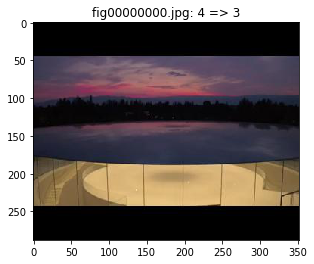

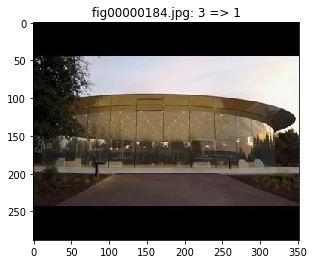

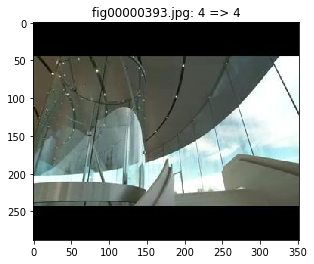

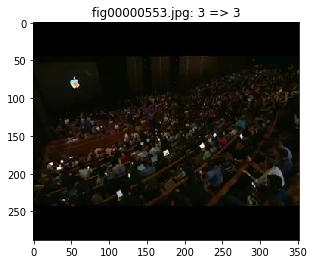

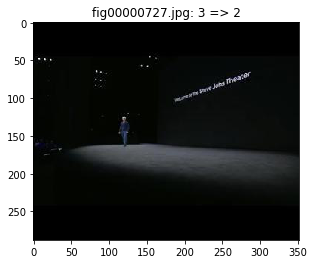

...

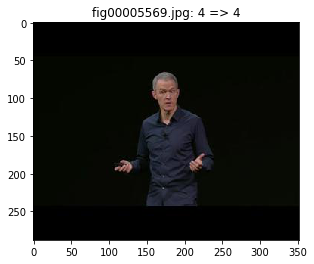

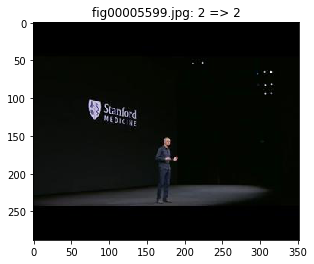

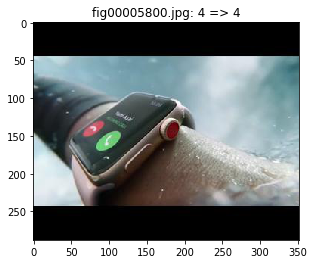

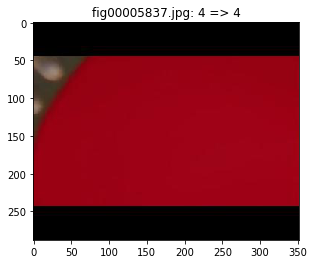

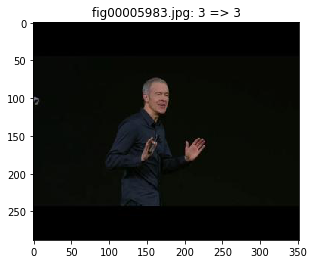

In [20]:
predict_movie('apple')

/home/gbudiman/anaconda3/envs/effigy/lib/python3.6/site-packages/matplotlib/pyplot.py:523: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


Ranked keyframe dumped to /home/gbudiman/Documents/effigy/figs/disney/ranked_keyframes.json


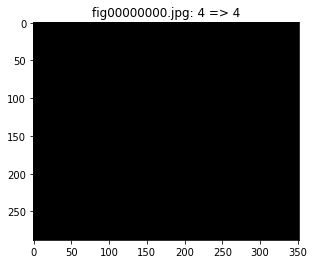

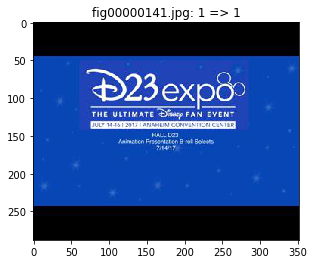

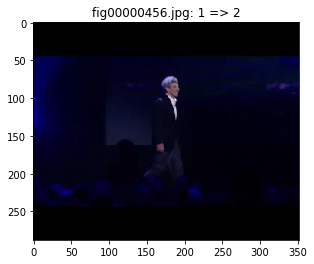

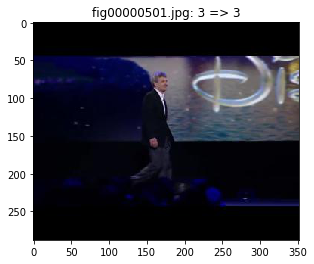

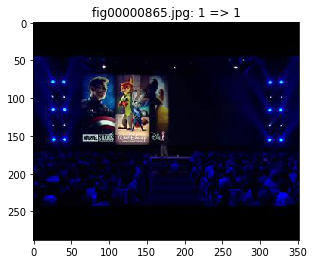

...

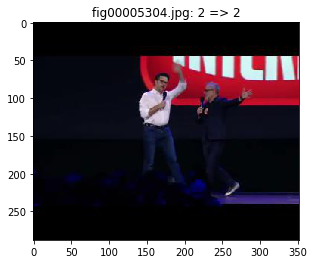

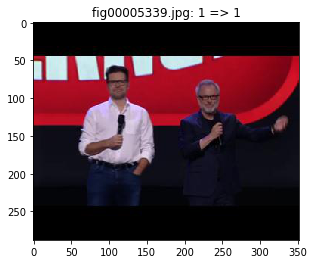

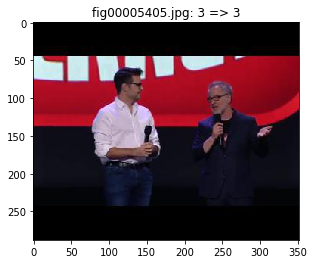

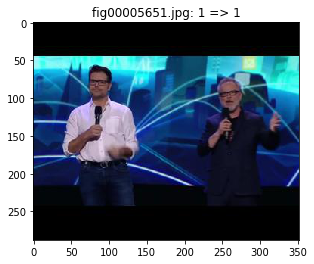

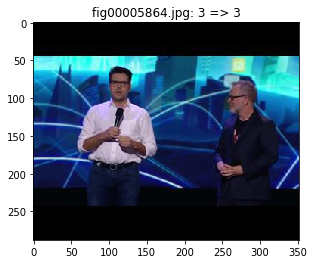

In [21]:
predict_movie('disney')

/home/gbudiman/anaconda3/envs/effigy/lib/python3.6/site-packages/matplotlib/pyplot.py:523: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


Ranked keyframe dumped to /home/gbudiman/Documents/effigy/figs/usc_week/ranked_keyframes.json


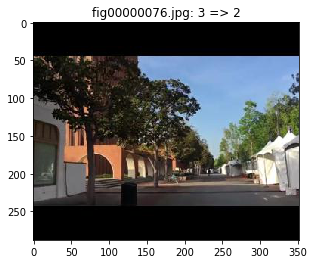

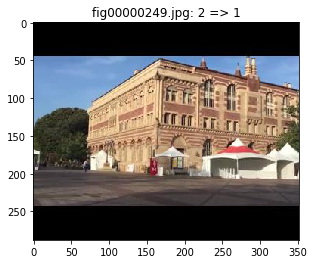

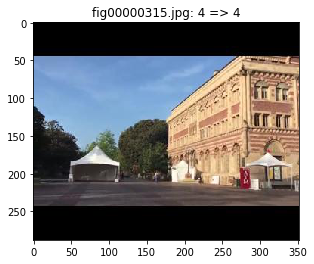

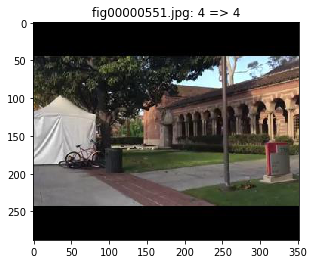

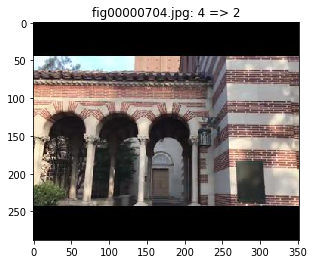

...

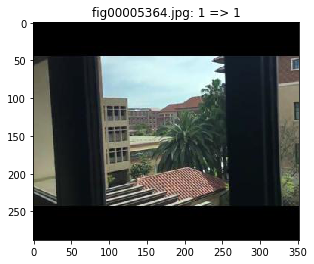

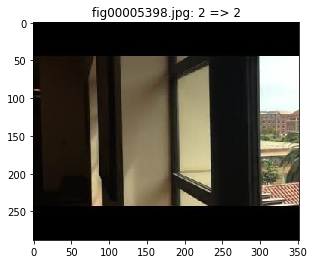

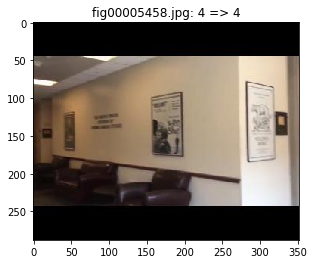

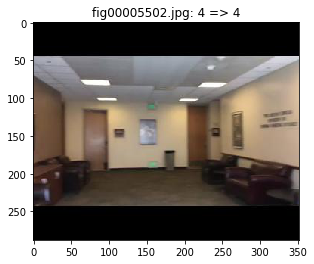

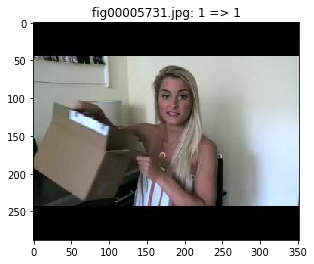

In [22]:
predict_movie('usc_week')

/home/gbudiman/anaconda3/envs/effigy/lib/python3.6/site-packages/matplotlib/pyplot.py:523: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


Ranked keyframe dumped to /home/gbudiman/Documents/effigy/figs/michael_day2/ranked_keyframes.json


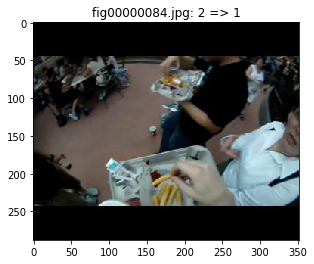

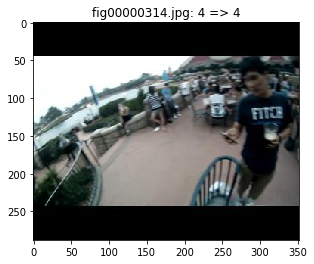

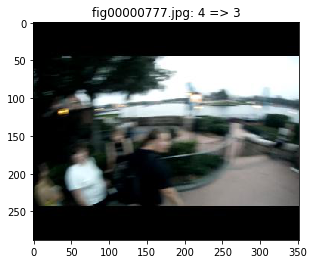

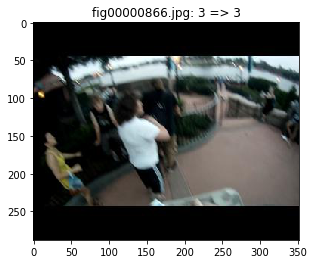

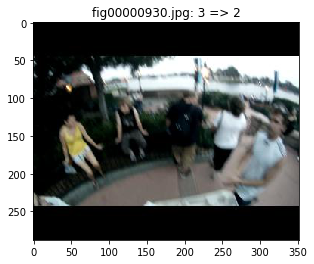

...

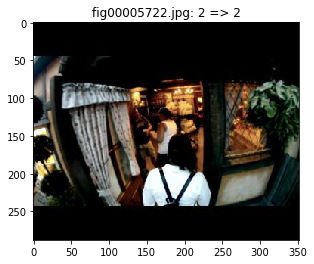

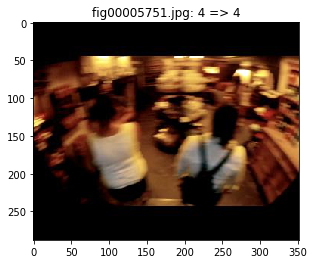

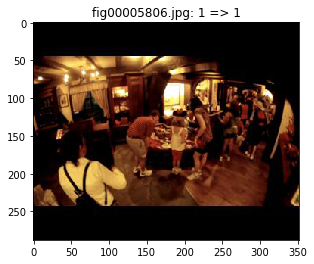

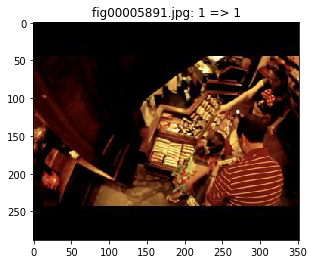

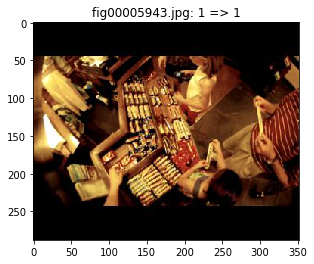

In [23]:
predict_movie('michael_day2')

/home/gbudiman/anaconda3/envs/effigy/lib/python3.6/site-packages/matplotlib/pyplot.py:523: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


Ranked keyframe dumped to /home/gbudiman/Documents/effigy/figs/hussein_day1/ranked_keyframes.json


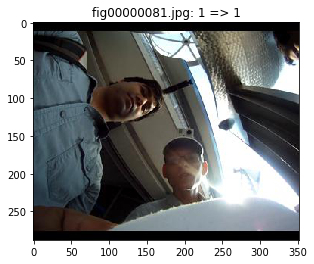

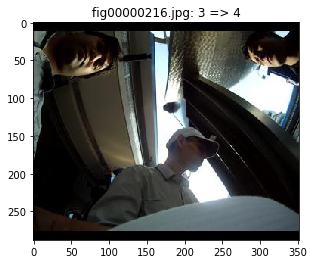

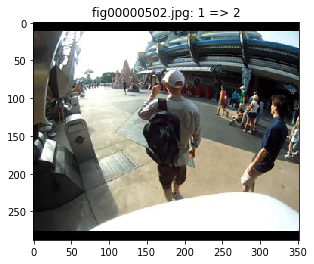

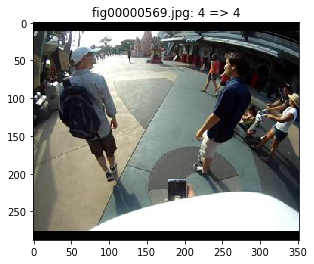

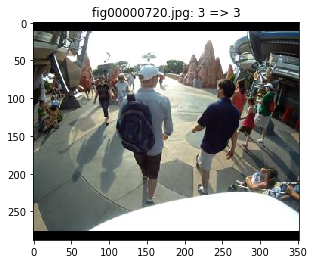

...

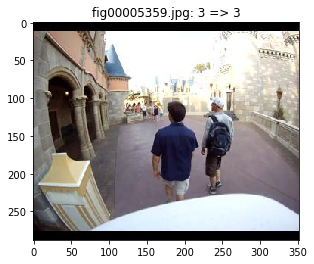

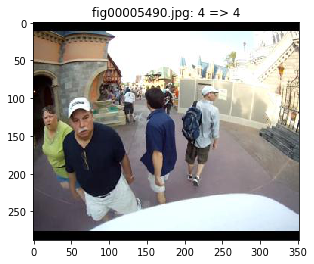

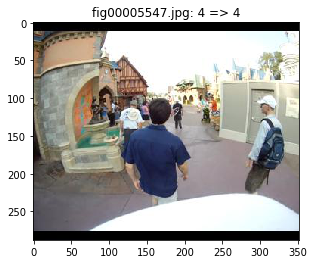

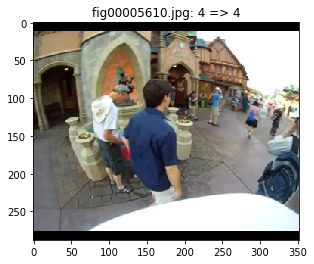

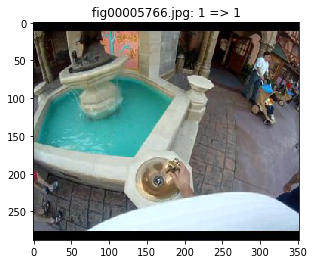

In [24]:
predict_movie('hussein_day1')